In [ ]:
cd /home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src

In [ ]:
import gsoup
import cv2
import numpy as np
from pathlib import Path

####


In [ ]:
import matplotlib.pyplot as plt

In [ ]:
texture = cv2.imread('/home/dcor/niskhizov/AdversarialRendering/mitsuba/colorful_pattern.jpg')#gsoup.generate_voronoi_diagram(512, 512, 1000)*0+255
# texture = np.zeros((1000, 1000, 3), dtype=np.float32) + 10
# texture[40:60,40:60,:] = 0

texture_file = Path("resource/synth_proj_texture.png")

gsoup.save_image(texture, texture_file)
#### from array, srgb response, raw and non-raw output
projected_texture = gsoup.to_float(texture)
projector_scene = gsoup.ProjectorScene()
projector_scene.create_default_scene(
    proj_texture=projected_texture,
    proj_brightness=3.0,
    proj_response_mode="srgb",
)
capture = projector_scene.capture(raw=True)
gsoup.write_exr(capture, "resource/synth_proj_srgb.exr")
capture = projector_scene.capture(raw=False)
gsoup.save_image(capture, "resource/synth_proj_srgb.png")
#### from array, gamma response
projected_texture = gsoup.to_float(texture)
projector_scene = gsoup.ProjectorScene()
projector_scene.create_default_scene(
    proj_texture=projected_texture,
    proj_brightness=3.0,
    proj_response_mode="gamma",
)
capture = projector_scene.capture(raw=False)
gsoup.save_image(capture, "resource/synth_proj_gamma.png")
#### from file, linear response
projector_scene = gsoup.ProjectorScene()
projector_scene.create_default_scene(
    proj_texture=texture_file,
    proj_brightness=3.0,
    proj_response_mode="linear",
)
capture = projector_scene.capture(raw=False)
gsoup.save_image(capture, "resource/synth_proj_linear.png")
#### set texture from array (linear response)
projector_scene.set_projector_texture(projected_texture)
capture = projector_scene.capture(raw=False)
gsoup.save_image(capture, "resource/synth_proj_set_texture_linear1.png")
### set texture from file (linear response)
projector_scene.set_projector_texture(texture_file)
capture = projector_scene.capture(raw=False)
gsoup.save_image(capture, "resource/synth_proj_set_texture_linear2.png")
# projector_scene.set_projector_transform(
#     np.array([[1, 0, 0, 0], [0, -1, 0, 0], [0, 0, -1, 0], [0, 0, 0, 1]])
# )  # this is the projector to world transform, it is identity in this case
# projector_scene.set_camera_transform(
#     np.array([[1, 0, 0, 0], [0, -1, 0, 0], [0, 0, -1, 0], [0, 0, 0, 1]])
# )  # this is the projector to world transform, it is identity in this case


In [ ]:
import cv2
import glob 
import matplotlib.pyplot as plt
d = '/home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src/resource'
for f in glob.glob(d + '/*.png'):
    print(f)
    img = cv2.imread(f)
    plt.imshow(img, aspect='auto')
    plt.show()




In [ ]:
raise

## MY

In [ ]:
cd /home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src

In [ ]:
# import mitsuba as mi

import mitsuba as mi
import drjit as dr
import numpy as np


mi.set_variant(
    "cuda_ad_rgb"
    # "scalar_rgb"
)  # "llvm_ad_rgb", "scalar_rgb" # must set before defining the emitter

# mi.set_variant('llvm_ad_rgb')


In [ ]:
from gsoup.image import (
    change_brightness,
    add_alpha,
    resize,
    tonemap_reinhard,
    linear_to_srgb,
)
import matplotlib.pyplot as plt

In [ ]:
import cv2

In [ ]:
import gsoup
from gsoup.projector_plugin_mitsuba import ProjectorPy
import mitsuba as mi
mi.register_emitter("projector_py", lambda props: ProjectorPy(props))


In [ ]:
texture = cv2.imread('/home/dcor/niskhizov/AdversarialRendering/mitsuba/colorful_pattern.jpg')#gsoup.generate_voronoi_diagram(512, 512, 1000)*0+255
# texture = np.zeros((1000, 1000, 3), dtype=np.float32) + 10
# texture[40:60,40:60,:] = 0
#### from array, srgb response, raw and non-raw output
proj_texture = gsoup.to_float(texture)

In [ ]:
# !python /home/dcor/niskhizov/AdversarialRendering/mitsuba/fun.py

In [ ]:
cam_wh=(256, 256)
cam_fov=45
proj_wh=(256, 256)
proj_fov=45
ambient_color=list(np.array([0.1, 0.1, 0.1] )*10)
proj_brightness = 30

spp=256
proj_response_mode = "srgb"

In [ ]:
import glob

bsdfs_rgb = glob.glob('/home/dcor/niskhizov/AdversarialRendering/mitsuba/bsdfs_rgb/*')

In [ ]:
# projector_scene = gsoup.ProjectorScene()


In [ ]:
patchs = glob.glob('/home/dcor/niskhizov/AdversarialRendering/botorch_snapshots/*patch*')

In [ ]:
plt.imshow(cv2.cvtColor(cv2.imread(patchs[0]), cv2.COLOR_BGR2RGB))

In [ ]:
roughness = [0.1, 0.4, 0.8]
metallics  = [0.0, 0.5, 1.0]

In [ ]:
for roughnes  in roughness:
    for metallic in metallics:
        for i in range(0):
            scene_dict = {
                    "type": "scene",
                    "proj_texture": {
                        "type": "bitmap",
                    },
                    "integrator": {
                        "type": "path",
                        "hide_emitters": True,
                        "max_depth": 6,
                    },
                    "camera": {
                        "type": "thinlens",
                        'aperture_radius': 0.02,  # control DoF (0.0 = pinhole)
                        'focus_distance': 5,  # meters to subject
                        "fov": cam_fov,
                        
                        "to_world": mi.ScalarTransform4f().look_at(
                            origin=[0.1, 0, 0.0],  # along +X axis
                            target=[0, 0, 0],
                            up=[0, 0, 1],  # Z-up
                        ),
                        "film": {
                            "type": "hdrfilm",
                            "width": cam_wh[0],
                            "height": cam_wh[1],
                            "pixel_format": "rgba",
                            "rfilter": {"type": "box"},
                        },
                        "sampler": {
                            "type": "independent",
                            "sample_count": spp,  # number of samples per pixel
                        },
                    },

                    "wall3": {
                        "type": "rectangle",
                        "to_world": mi.ScalarTransform4f()
                        .translate([-2.0, 0.0, 0.0])
                        .rotate([0, 1, 0], 90),
                        # "flip_normals": True,
                        # 'reflectance': {
                        #     'type': 'bitmap',
                        #     'filename': '/home/dcor/niskhizov/AdversarialRendering/mitsuba/mat_data/WoodFloor064_1K/WoodFloor064_1K-JPG_Color.jpg',
                        # },
                        "bsdf": 
                        {

                        'type': 'principled',
                        'base_color': {
                            'type': 'bitmap',
                            # 'filename': '/home/dcor/niskhizov/AdversarialRendering/mitsuba/whitesqure.png',
                            'filename': f'{patchs[i]}',

                        },
                        'roughness' : roughnes,
                        'metallic': metallic,
                        # 'base_color': {'type': 'rgb', 'value': [1.0, 1.0, 1.0]},
                        # 'metallic':metallic,
                        # 'specular': specular,
                        # 'roughness': 1.0,
                        # 'spec_tint': 0.4,
                        # 'anisotropic': 0.5,
                        # 'sheen': 0.3,
                        # 'sheen_tint': 0.2,
                        # 'clearcoat': 0.6,
                        # 'clearcoat_gloss': 0.3,
                        # 'spec_trans': 0.4

                            # "type": "diffuse",
                            # "reflectance": {"type": "rgb", "value": [1.0, 1.0, 1.0]},

                        # 'type': 'measured',
                        # 'filename': f'{bsdfs_rgb[i]}'


                        },
                    },

                    "projector": {
                        "type": "projector_py",
                        "irradiance": {
                            # "type": "ref",
                            # "id": "proj_texture",
                            "type": "bitmap",
                            'filename': '/home/dcor/niskhizov/AdversarialRendering/mitsuba/whitesqure.png',
                            # "raw": True,  # assuming the image is in linear RGB
                            'format' : 'variant'
                        },
                        "scale": proj_brightness,
                        "to_world": mi.ScalarTransform4f().look_at(
                            origin=[0.005, 0, 0],  # along +X axis
                            target=[0, 0, 0],
                            up=[0, 0, 1],  # Z-up
                        ),
                        "fov": proj_fov,
                        "response_mode": proj_response_mode,
                    },

                    # "projector": {

                    #         'type': 'projector',
                    #         "irradiance": {
                    #             "type": "ref",
                    #             "id": "proj_texture",},
                    #         'fov': 45,
                    #         "to_world": mi.ScalarTransform4f().look_at(
                    #             origin=[0.005, 0, 0],  # along +X axis
                    #             target=[0, 0, 0],
                    #             up=[0, 0, 1],  # Z-up
                    #         ), },



                    
                    
                    "ambient": {
                        "type": "constant",
                        "radiance": {"type": "rgb", "value": ambient_color},
                    },
                }


            scene_dict["proj_texture"]["data"] = proj_texture
            scene = mi.load_dict(scene_dict)



            raw_render = mi.render(scene)
            # mi.util.write_bitmap("test.exr", raw_render)
            np_render = np.array(raw_render)

            alpha = np_render[:, :, -1:]
            image = np_render[:, :, :3]
            # no_alpha_render = gsoup.alpha_compose(render)
            image = tonemap_reinhard(image, exposure=1.0)
            image = linear_to_srgb(image)
            final_image = add_alpha(image, alpha)

            # print(f"Rendering {bsdfs[i]}")
            plt.imshow(final_image, aspect='auto')
            plt.show()

## Training

In [3]:
cd /home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src

/home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src


In [ ]:
import os
while True:
    os.system('/home/dcor/niskhizov/anaconda3/bin/python /home/dcor/niskhizov/AdversarialRendering/mitsuba/train.py')

In [ ]:
gsoup

<module 'gsoup' from '/home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src/gsoup/__init__.py'>

In [4]:
import glob
import mitsuba as mi
import drjit as dr
import numpy as np
import cv2
from gsoup.image import (
    change_brightness,
    add_alpha,
    resize,
    tonemap_reinhard,
    linear_to_srgb,
)
import matplotlib.pyplot as plt

mi.set_variant(
    "cuda_ad_rgb"
    # "scalar_rgb"
)  # "llvm_ad_rgb", "scalar_rgb" # must set before defining the emitter


patchs = glob.glob('/home/dcor/niskhizov/AdversarialRendering/botorch_snapshots/*patch*')

cam_wh=(256, 256)
cam_fov=45
proj_wh=(256, 256)
proj_fov=45
ambient_color=list(np.array([0.1, 0.1, 0.1] )*10)
proj_brightness = 30

spp=256
proj_response_mode = "srgb"

import gsoup
from gsoup.projector_plugin_mitsuba import ProjectorPy
import mitsuba as mi
mi.register_emitter("projector_py", lambda props: ProjectorPy(props))


In [5]:
# roughness = list(range(0.1,0.8, 0.1))
# metallics  = list(range(0, 1.0, 0.1))

roughness = list(np.arange(0.1, 0.8, 0.1))

metallics  = list(np.arange(0, 1.0, 0.1))


def generate_random_scene():
    """
    Generate a random scene dictionary for Mitsuba.
    """            
    random_patch = np.random.choice(patchs)
    roughnes =  np.random.choice(roughness)
    metallic = np.random.choice(metallics)

    proj_brightness = np.random.uniform(1.0, 10.0)

    ambient_color_scale = np.random.uniform(0.1, 1.0)

    ambient_color=list(np.array([1.0,1.0,1.0] )*ambient_color_scale)

    focus_distance = np.random.uniform(1.0, 20.0)

    scene_dict = {

                    "type": "scene",

                    "integrator": {
                        "type": "path",
                        "hide_emitters": True,
                        "max_depth": 6,
                    },
                    "camera": {
                        "type": "thinlens",
                        'aperture_radius': 0.02,  # control DoF (0.0 = pinhole)
                        'focus_distance': focus_distance,  # meters to subject
                        "fov": cam_fov,
                        
                        "to_world": mi.ScalarTransform4f().look_at(
                            origin=[0.1, 0, 0.0],  # along +X axis
                            target=[0, 0, 0],
                            up=[0, 0, 1],  # Z-up
                        ),
                        "film": {
                            "type": "hdrfilm",
                            "width": cam_wh[0],
                            "height": cam_wh[1],
                            "pixel_format": "rgba",
                            "rfilter": {"type": "box"},
                        },
                        "sampler": {
                            "type": "independent",
                            "sample_count": spp,  # number of samples per pixel
                        },
                    },

                    "wall3": {
                        "type": "rectangle",
                        "to_world": mi.ScalarTransform4f()
                        .translate([-2.0, 0.0, 0.0])
                        .rotate([0, 1, 0], 90),
                        "bsdf": 
                        {

                        'type': 'principled',
                        'base_color': {
                            'type': 'bitmap',
                            'filename': f'{random_patch}',

                        },
                        'roughness' : roughnes,
                        'metallic': metallic,
                        },
                    },

                    "projector": {
                        "type": "projector_py",
                        "irradiance": {
                            # "type": "ref",
                            # "id": "proj_texture",
                            "type": "bitmap",
                            'filename': '/home/dcor/niskhizov/AdversarialRendering/mitsuba/mat_data/WoodFloor064_1K/WoodFloor064_1K-JPG_Color.jpg',
                            # "raw": True,  # assuming the image is in linear RGB
                            'format' : 'variant'
                        },
                        "scale": proj_brightness,
                        "to_world": mi.ScalarTransform4f().look_at(
                            origin=[0.005, 0, 0],  # along +X axis
                            target=[0, 0, 0],
                            up=[0, 0, 1],  # Z-up
                        ),
                        "fov": proj_fov,
                        "response_mode": proj_response_mode,
                    },
                    
                    "ambient": {
                        "type": "constant",
                        "radiance": {"type": "rgb", "value": ambient_color},
                    },
                }
    
    return scene_dict

In [6]:
# params = mi.traverse(scene)


In [7]:
import torch



In [8]:

@dr.wrap(source='torch', target='drjit')
def render_texture2(params, proj_tex_grad):



    params['projector.irradiance.data'] = proj_tex_grad 
    params.update()

    raw_render = mi.render(scene, params)



    return raw_render

def render(params, proj_tex_grad):

    raw_render = render_texture2(params,proj_tex_grad)


    alpha = raw_render[:, :, -1:]
    image = raw_render[:, :, :3]
    # no_alpha_render = gsoup.alpha_compose(render)
    image = tonemap_reinhard(image, exposure=1.0)
    # image = linear_to_srgb(image)
    final_image = add_alpha(image, alpha)

    return final_image[:,:,:3]






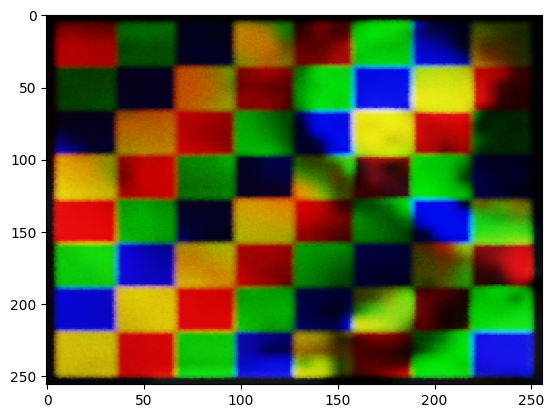

In [9]:
texture = cv2.imread('/home/dcor/niskhizov/AdversarialRendering/mitsuba/colorful_pattern.jpg')#gsoup.generate_voronoi_diagram(512, 512, 1000)*0+255
proj_texture = gsoup.to_float(texture)

scene_dict = generate_random_scene()

scene = mi.load_dict(scene_dict)


params = mi.traverse(scene)

proj_tex_grad = torch.from_numpy(proj_texture).requires_grad_(True).cuda()  # Convert to (C, H, W) format for PyTorch

final_image = render(params, proj_tex_grad)

plt.imshow(final_image.detach().cpu().numpy(), aspect='auto')

In [10]:
import torchvision

resizer = torchvision.transforms.Resize((256, 256))

In [16]:
num_anchors = 10
learnable_anchors = torch.rand(num_anchors, 3, 10, 10).cuda()  # Example learnable anchors
learnable_anchors = learnable_anchors.requires_grad_(True)

proj_tex = torch.from_numpy(proj_texture).cuda() 
proj_tex_r = resizer(proj_tex.permute(2, 0, 1))

In [17]:
class AnchorsCnnDownsample(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(AnchorsCnnDownsample, self).__init__()
        self.layers = torch.nn.Sequential(
            torch.nn.Conv2d(3, 16, kernel_size=3, stride=2, padding=1),
            torch.nn.ReLU(),
            torch.nn.Conv2d(16, 16, kernel_size=3, stride=2, padding=1),
            torch.nn.ReLU(),
            torch.nn.Conv2d(16, 16, kernel_size=3, stride=2, padding=1),
            torch.nn.ReLU(),
            torch.nn.Conv2d(16, 16, kernel_size=3, stride=2, padding=1),
            torch.nn.ReLU(),
        )
        self.deconv = torch.nn.Sequential(
            torch.nn.ConvTranspose2d(num_anchors*16, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose2d(16, 16, kernel_size=3, stride=2, padding=1, output_padding=1),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose2d(16, 8, kernel_size=3, stride=2, padding=1, output_padding=1),
            torch.nn.ReLU(),
            torch.nn.ConvTranspose2d(8, 3, kernel_size=3, stride=2, padding=1, output_padding=1),
        )

        # self.fc =  torch.nn.Sequential(
        #     torch.nn.Linear(8 * 16 * 16, 32),  # Assuming input size is 400x400
        #     torch.nn.ReLU(),
        #     torch.nn.Linear(32, 32),  
        #     torch.nn.ReLU(),
        # )

        # self.fc2 = torch.nn.Sequential(torch.nn.Linear(32*learnable_anchors.shape[0], 1024),
        #                                 torch.nn.ReLU(),
        #                                 torch.nn.Linear(1024, 1024),
        #                                 torch.nn.ReLU(),
                                       
                                       
        #                                )

    def forward(self, x):
        # print(x.shape)
        x = self.layers(x)#.reshape(3*learnable_anchors.shape[0], 256, 256))  
        # print(x.shape)
        x = self.deconv(x.reshape(num_anchors*16, 16, 16))  
        # print(x.shape)
        # x = x.reshape(x.size(0), -1)  # Flatten the tensor
        # x = self.fc(x)
        # x = x.reshape(-1)
        # x = self.fc2(x)
        return x
    

import torch.nn as nn

class LightCNN(nn.Module):
    def __init__(self):
        super(LightCNN, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(6, 8, kernel_size=3, padding=1),  # 4x60x80 -> 8x60x80
            nn.LeakyReLU(),
            nn.Conv2d(8, 16, kernel_size=3, padding=1), # 8x60x80 -> 16x60x80
            nn.LeakyReLU(),
            nn.Conv2d(16, 32, kernel_size=3, padding=1), # 8x60x80 -> 16x60x80
            nn.LeakyReLU(),
            nn.Conv2d(32, 16, kernel_size=3, padding=1), # 8x60x80 -> 16x60x80
            nn.LeakyReLU(),
        )
        self.decoder = nn.Sequential(
            nn.Conv2d(16, 8, kernel_size=3, padding=1), # 16x60x80 -> 8x60x80
            nn.LeakyReLU(),
            nn.Conv2d(8, 3, kernel_size=3, padding=1) )  # 8x60x80 -> 4x60x80
        


    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x
        


In [18]:
learnable_anchors = torch.load('learnable_anchors.pth')
light_cnn_sd = torch.load('light_cnn.pth')
cnn_downsample_sd = torch.load('cnn_downsample.pth')
# learnable_anchors = torch.load('./best_ckpt/learnable_anchors.pth')
# light_cnn_sd = torch.load('./best_ckpt/light_cnn.pth')
# cnn_downsample_sd = torch.load('./best_ckpt/cnn_downsample.pth')

In [19]:
learnable_anchors.shape

torch.Size([10, 3, 10, 10])

In [20]:
from torch import optim

cnn_ds = AnchorsCnnDownsample(3, 64).cuda()
model = LightCNN().cuda()    

cnn_ds.load_state_dict(cnn_downsample_sd)
model.load_state_dict(light_cnn_sd)

optimizer = optim.Adam([learnable_anchors,*cnn_ds.parameters(), *model.parameters()], lr=1e-3)


In [ ]:
projected_anchors = []
for anchor in learnable_anchors:
    resized_anchor = resizer(anchor)  # Change to HWC format
    projected_anchors.append(render(params, resized_anchor.permute(1,2,0)))


In [ ]:
mi.set_log_level(mi.LogLevel.Error)  # Suppress Mitsuba logs

In [ ]:
import tqdm

In [ ]:
proj_tex_r.shape

torch.Size([3, 256, 256])

In [24]:
from torchmetrics.image import TotalVariation

In [25]:
tv = TotalVariation().cuda()

In [26]:
caltec_photos = '/home/dcor/niskhizov/caltech-101/101_ObjectCategories/'
ls = glob.glob(caltec_photos + '/*/*.jpg')

In [34]:
m = cv2.imread(ls[100])

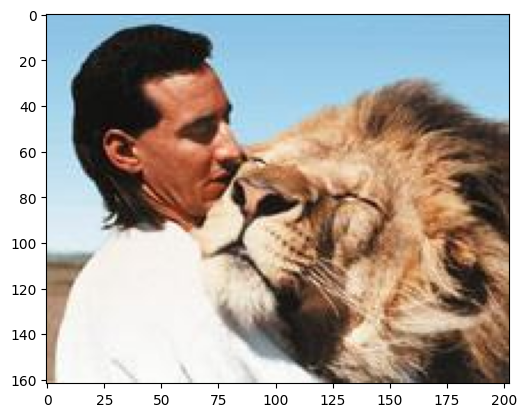

In [39]:
plt.imshow(cv2.cvtColor(cv2.imread(ls[20]), cv2.COLOR_BGR2RGB))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


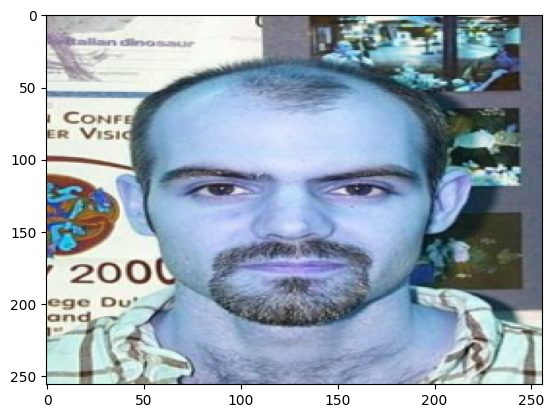

In [32]:
plt.imshow(proj_tex_r.permute(1,2,0).detach().cpu().numpy(), aspect='auto')

  0%|          | 0/10000 [00:00<?, ?it/s]

Epoch 1, Loss: 0.013321037404239178


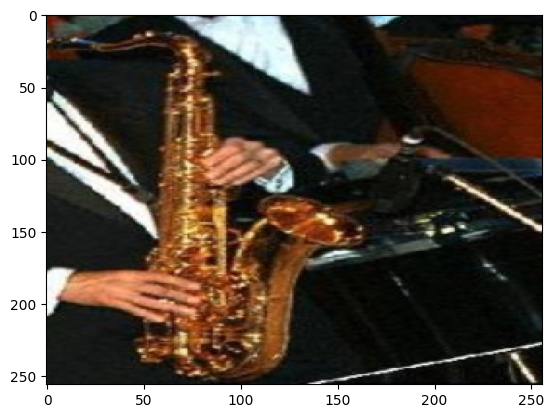

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0018162876..0.91318846].


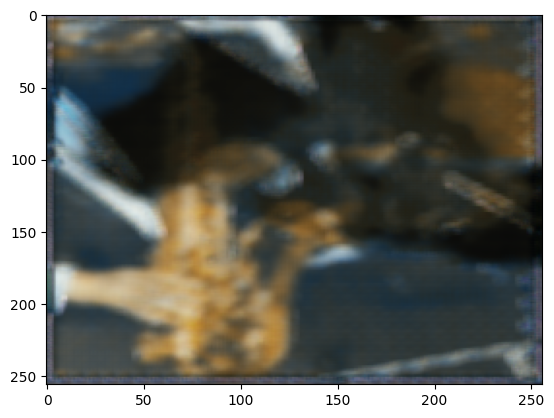

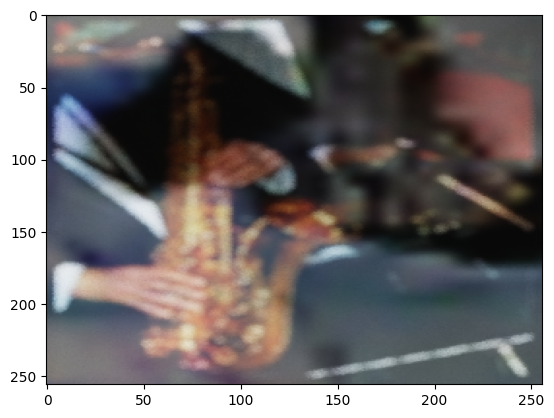

  0%|          | 1/10000 [00:03<9:13:29,  3.32s/it]

Epoch 2, Loss: 0.008043458685278893


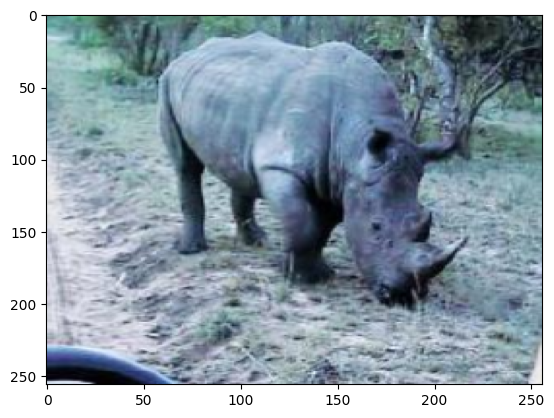

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.01600559..0.9020373].


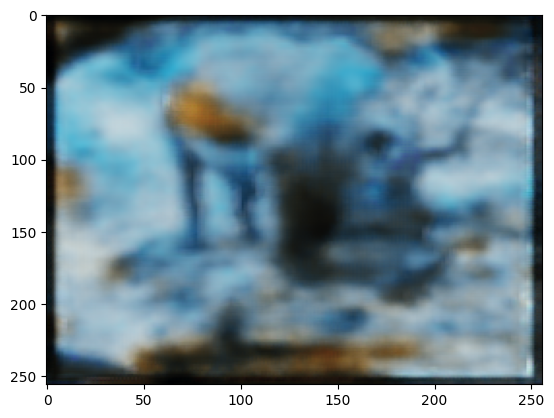

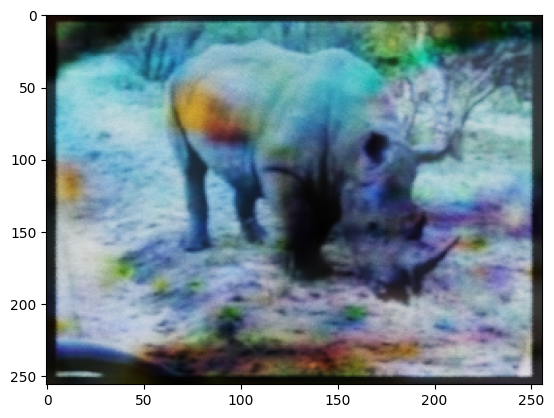

  0%|          | 2/10000 [00:06<8:28:13,  3.05s/it]

Epoch 3, Loss: 0.020503422245383263


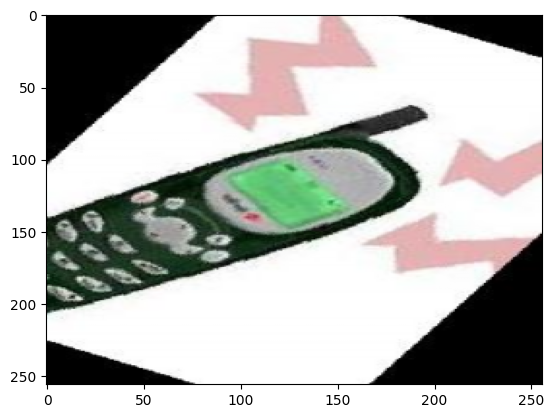

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025761..1.017528].


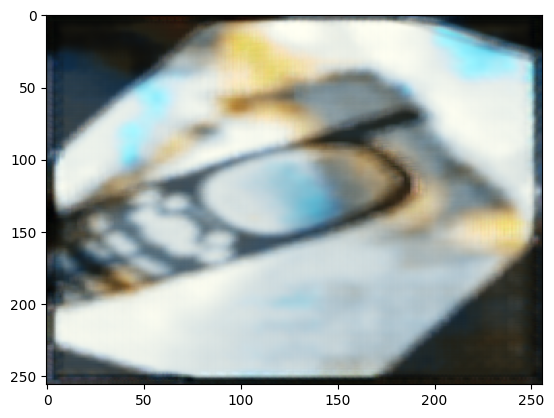

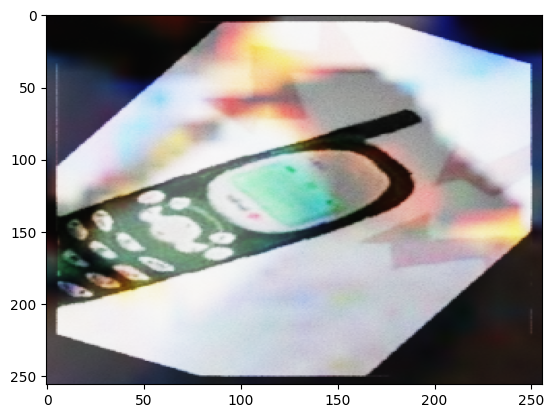

  0%|          | 3/10000 [00:08<8:06:05,  2.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


Epoch 4, Loss: 0.005751601420342922


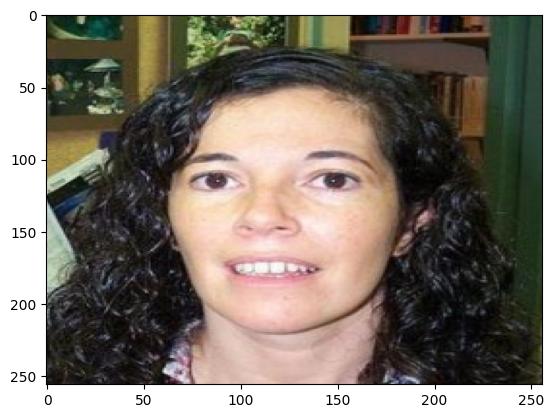

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0065841526..0.9081639].


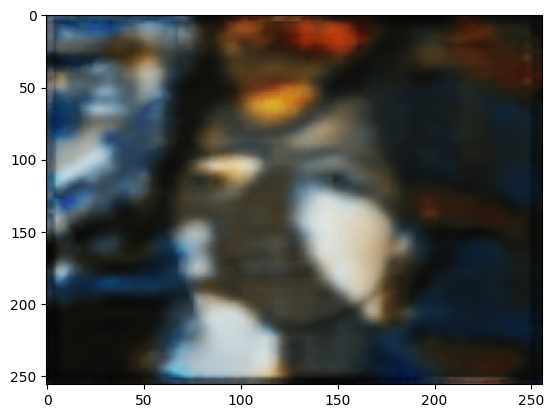

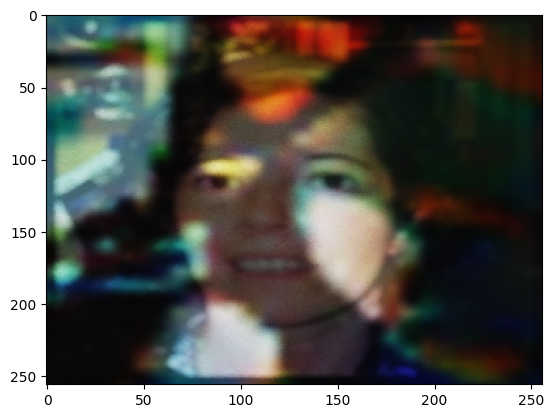

  0%|          | 4/10000 [00:11<7:59:23,  2.88s/it]

Epoch 5, Loss: 0.0021171318367123604


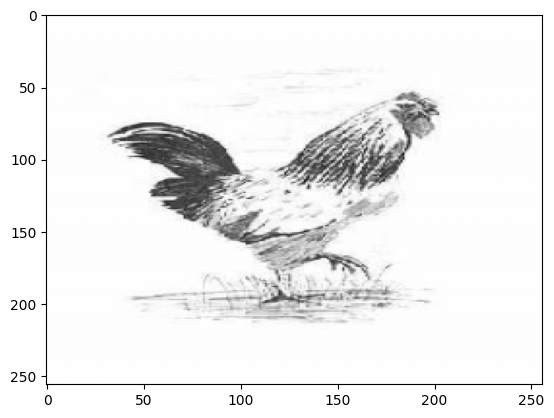

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.017613575..0.7279832].


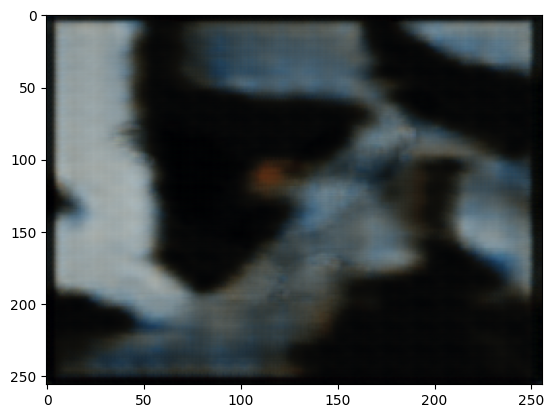

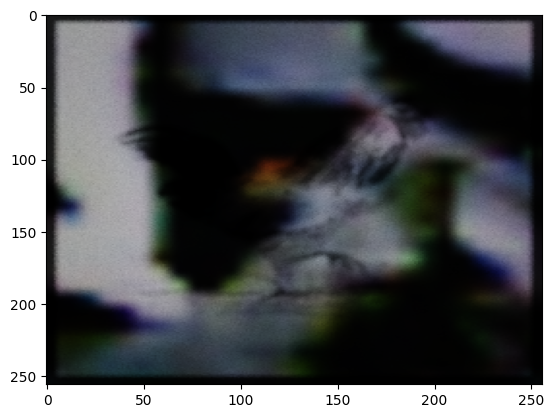

  0%|          | 5/10000 [00:14<7:47:22,  2.81s/it]

Epoch 6, Loss: 0.004040900617837906


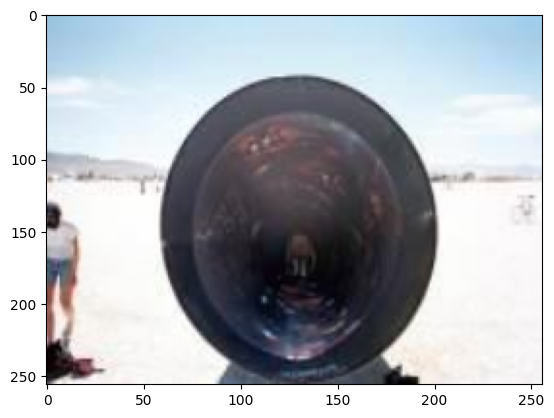

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015973493..0.84792376].


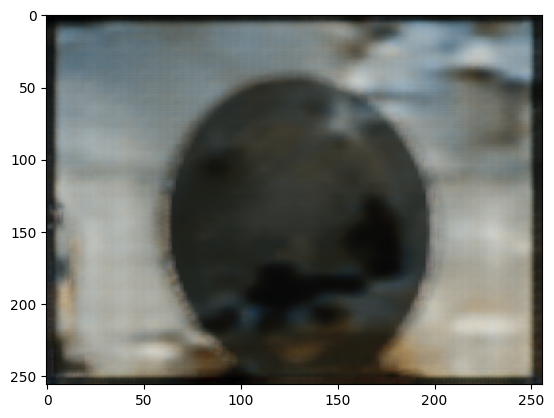

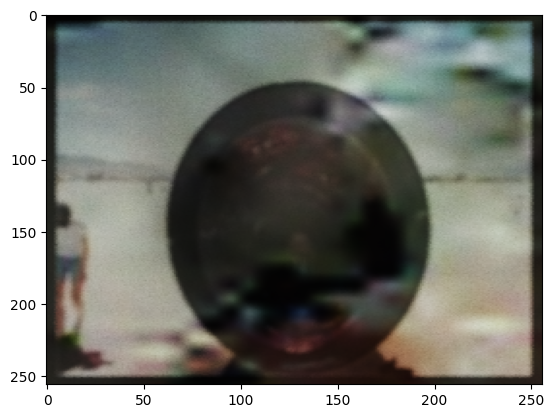

  0%|          | 6/10000 [00:17<7:44:32,  2.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


Epoch 7, Loss: 0.003235597163438797


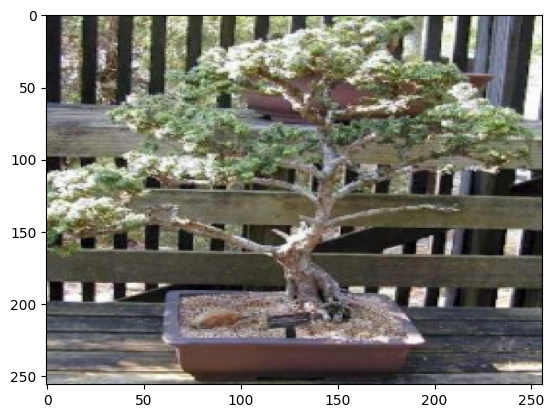

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.049010113..0.9180777].


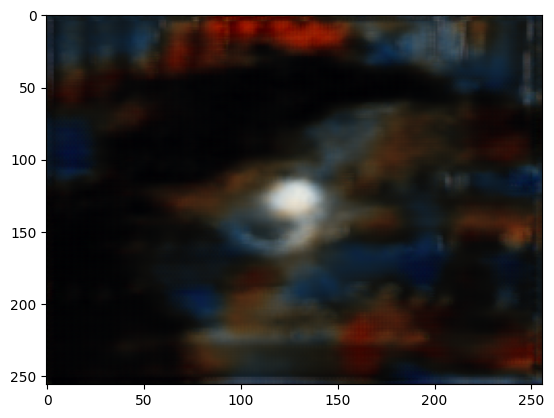

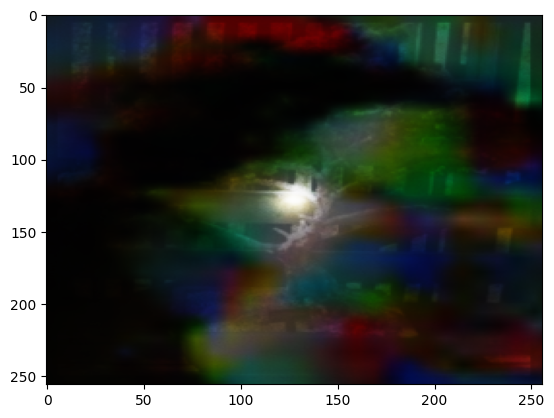

  0%|          | 7/10000 [00:19<7:28:21,  2.69s/it]

Epoch 8, Loss: 0.00834246538579464


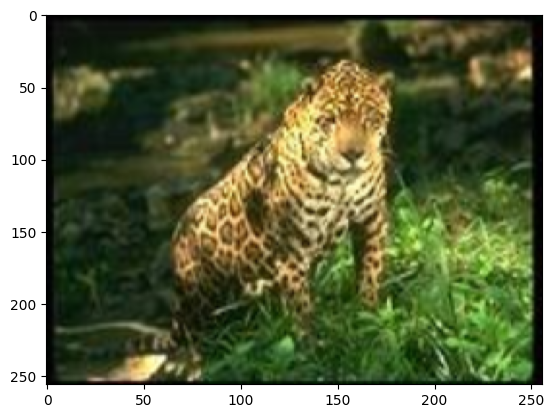

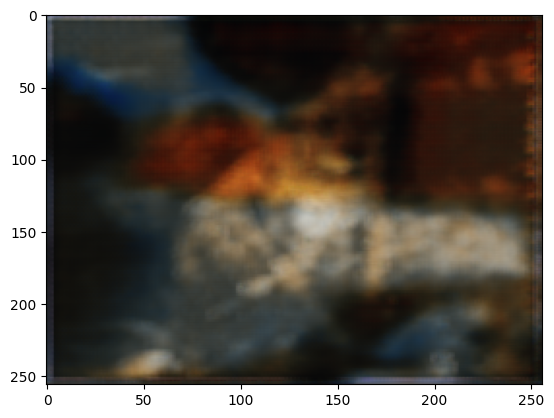

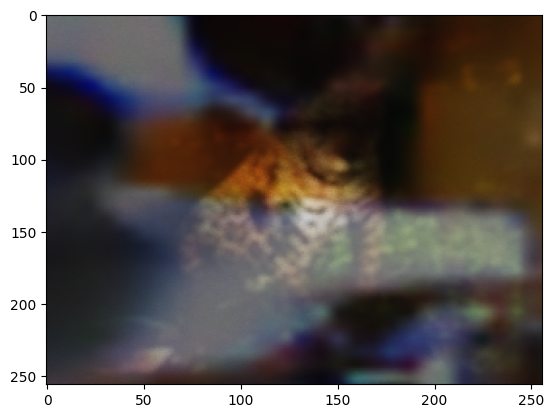

  0%|          | 8/10000 [00:22<7:22:36,  2.66s/it]

Epoch 9, Loss: 0.003971823491156101


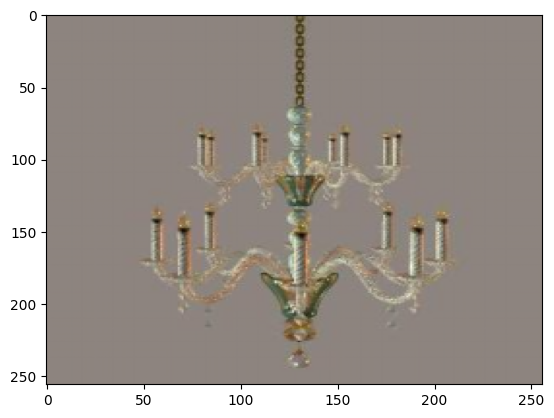

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.016320378..0.7528047].


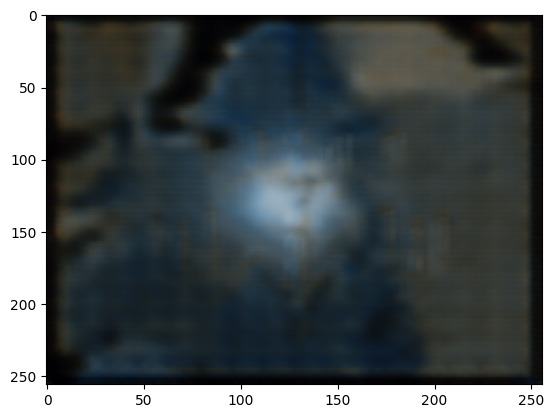

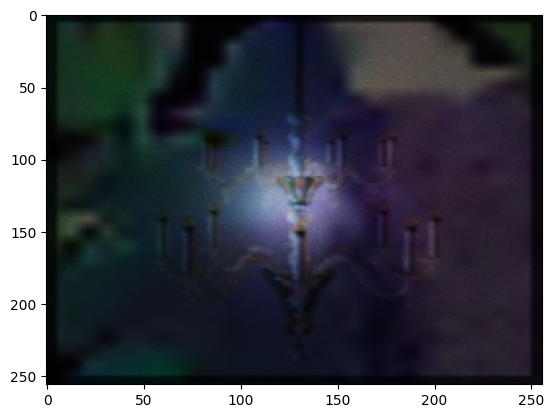

  0%|          | 9/10000 [00:25<7:37:25,  2.75s/it]

Epoch 10, Loss: 0.004604136571288109


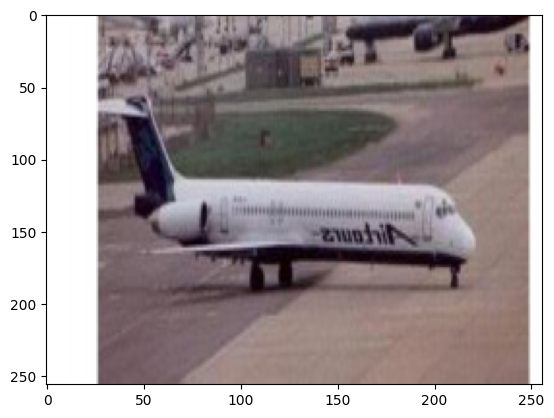

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0198647..0.9992198].


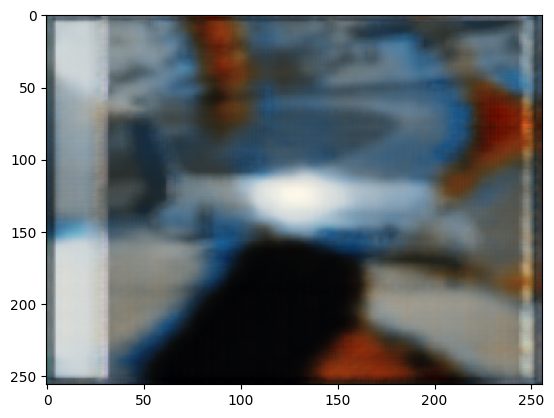

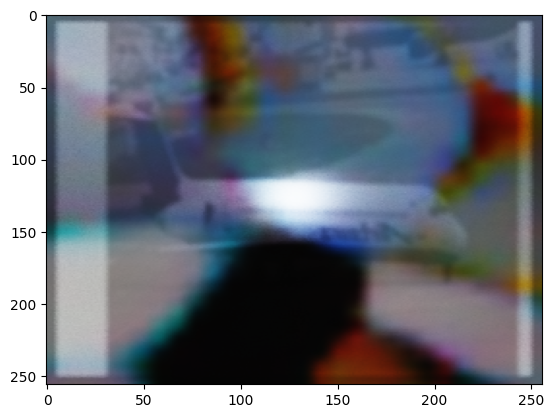

  0%|          | 10/10000 [00:27<7:24:38,  2.67s/it]

Epoch 11, Loss: 0.004600305110216141


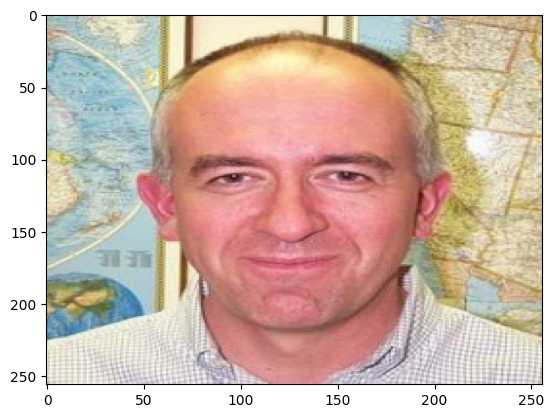

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013903104..0.9639461].


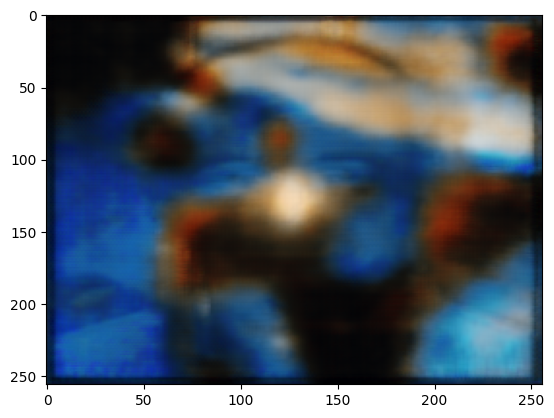

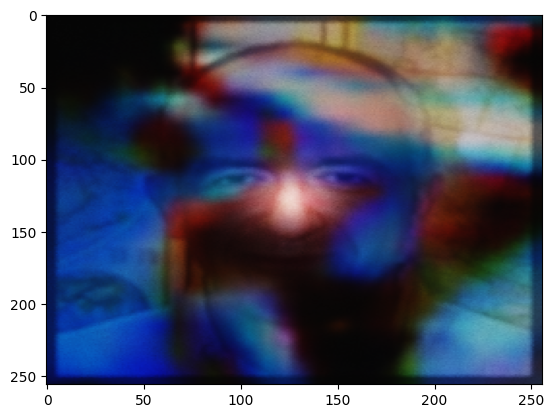

  0%|          | 11/10000 [00:30<7:17:24,  2.63s/it]

Epoch 12, Loss: 0.009072808548808098


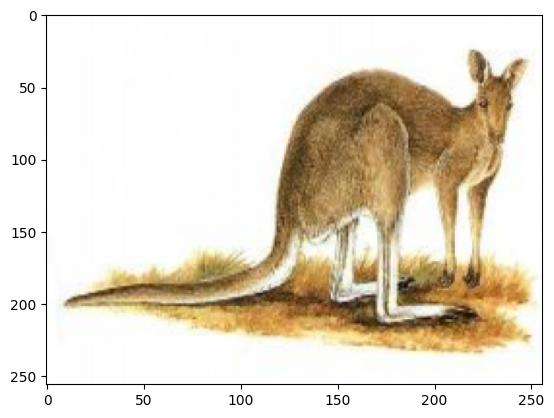

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.045719765..0.9665229].


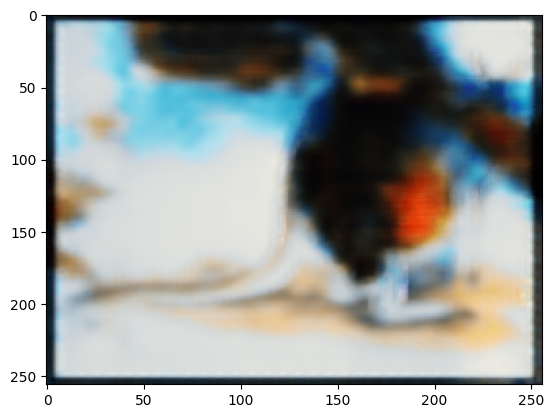

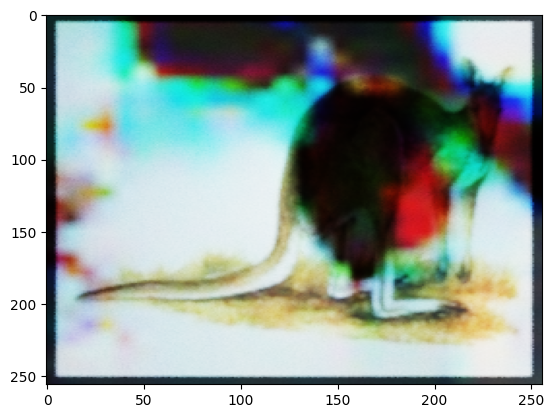

  0%|          | 12/10000 [00:33<7:33:03,  2.72s/it]

Epoch 13, Loss: 0.006721880286931992


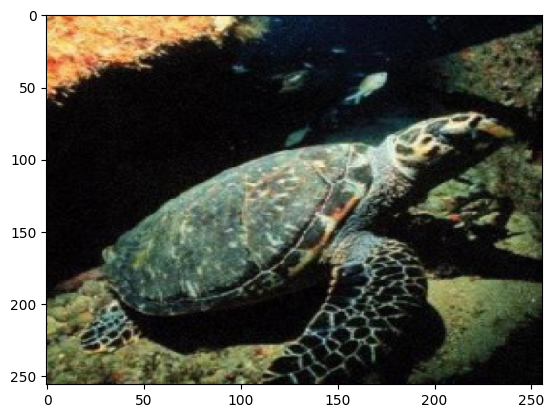

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04479146..0.93793476].


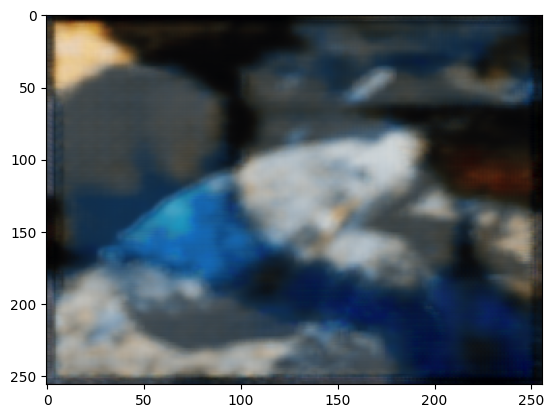

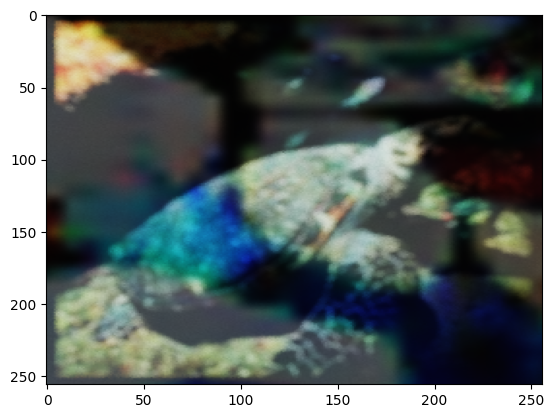

  0%|          | 13/10000 [00:35<7:36:41,  2.74s/it]

Epoch 14, Loss: 0.0049519725143909454


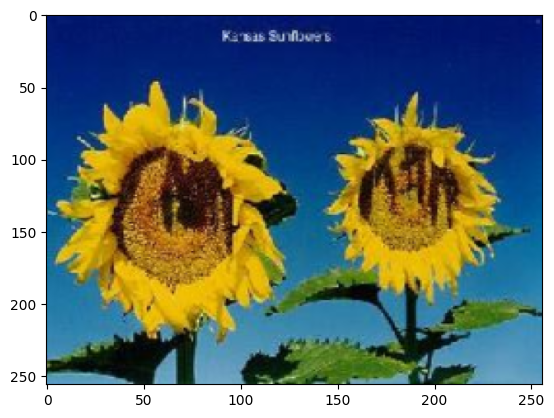

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07278286..1.017513].


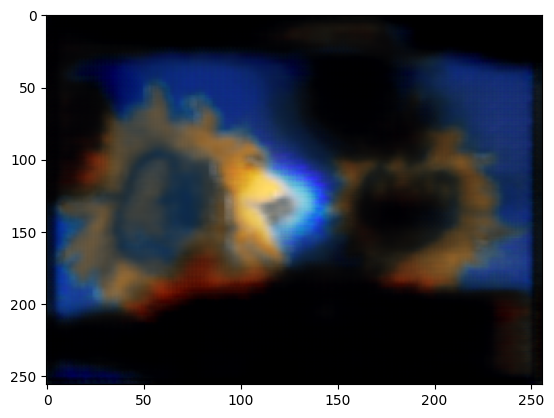

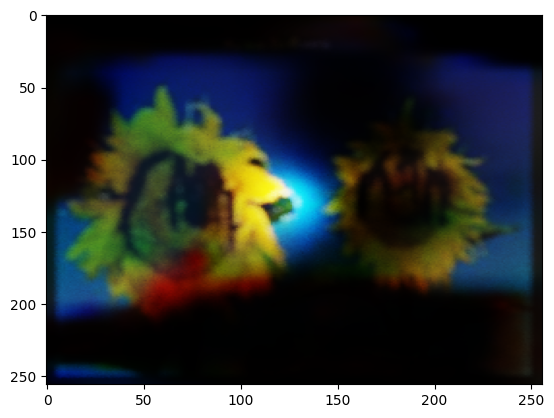

  0%|          | 14/10000 [00:38<7:20:55,  2.65s/it]

Epoch 15, Loss: 0.003646277589723468


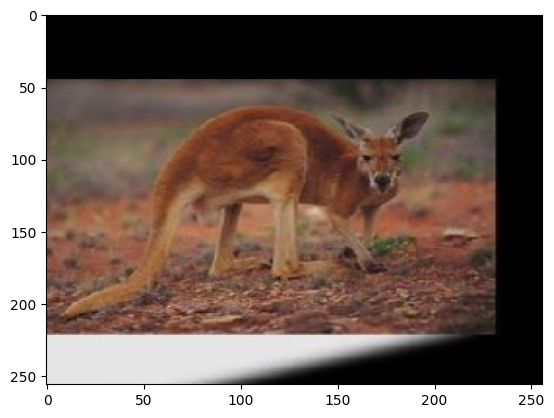

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.044210866..0.9532202].


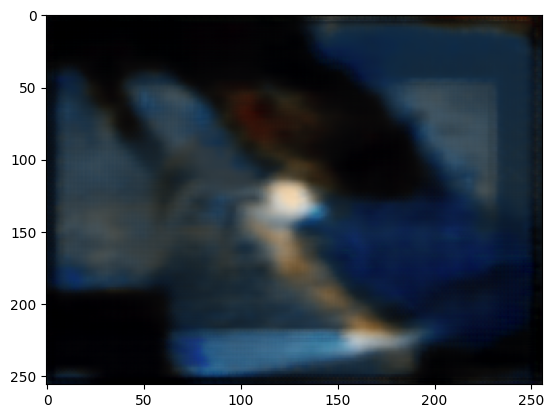

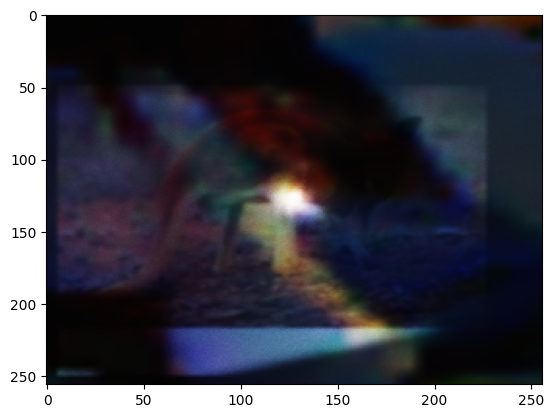

  0%|          | 15/10000 [00:40<7:11:13,  2.59s/it]

Epoch 16, Loss: 0.012056304141879082


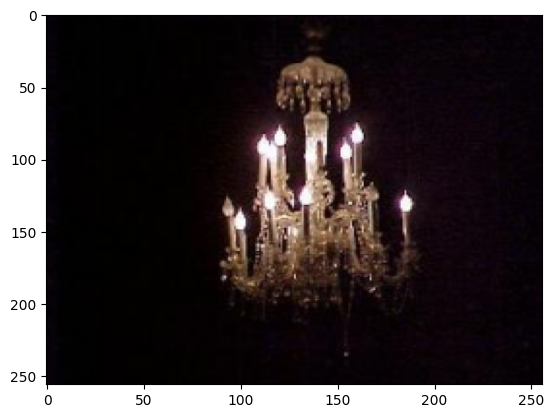

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.058516905..0.948997].


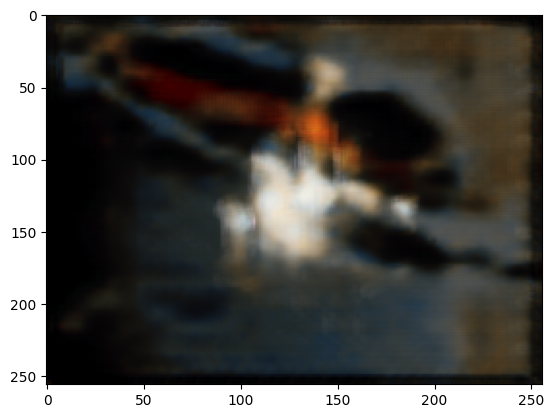

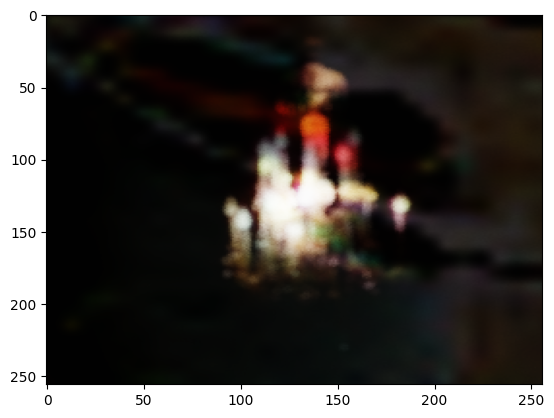

  0%|          | 16/10000 [00:43<7:02:40,  2.54s/it]

Epoch 17, Loss: 0.0049979411996901035


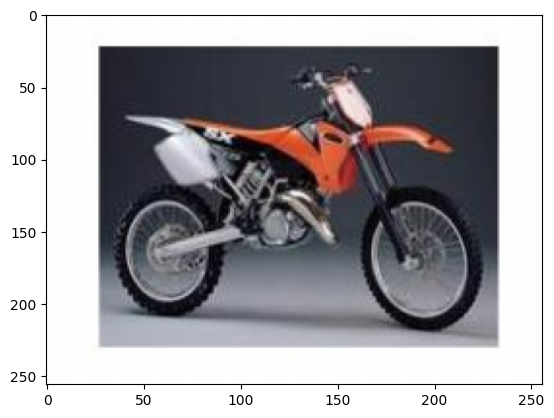

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.055861026..0.69437087].


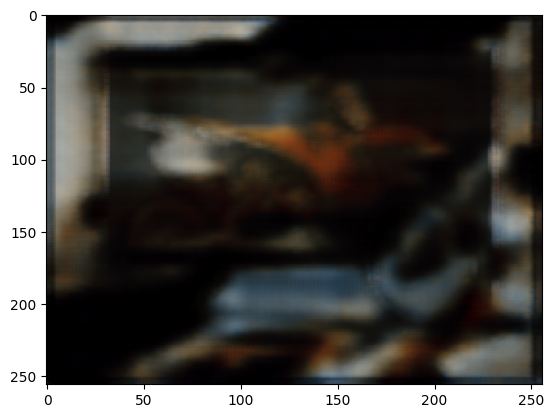

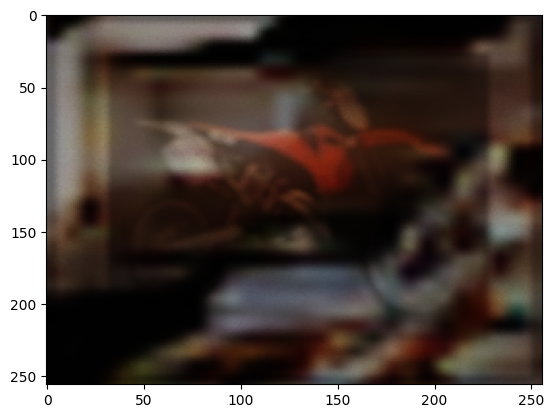

  0%|          | 17/10000 [00:45<7:08:49,  2.58s/it]

Epoch 18, Loss: 0.012619826942682266


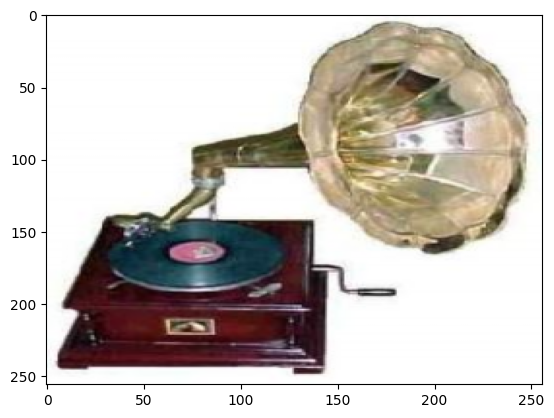

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.04155811..0.88275504].


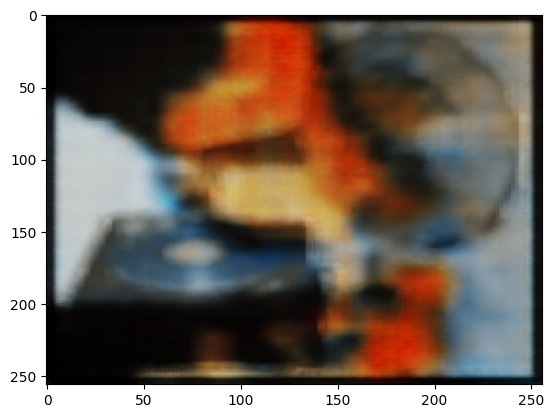

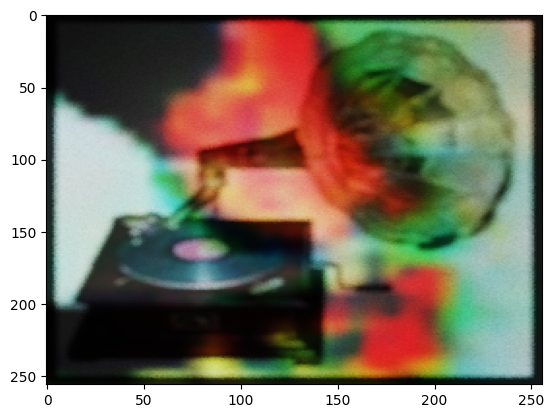

  0%|          | 18/10000 [00:48<7:15:47,  2.62s/it]

Epoch 19, Loss: 0.014127570204436779


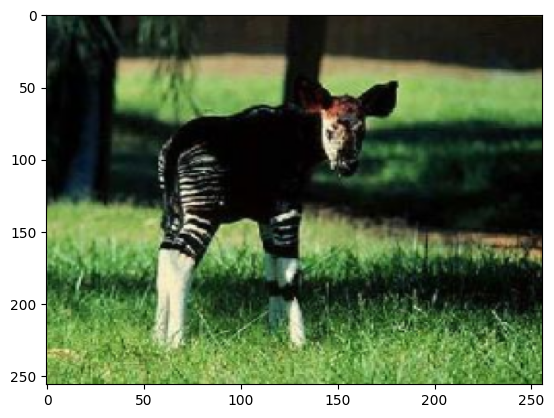

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025546119..0.8996787].


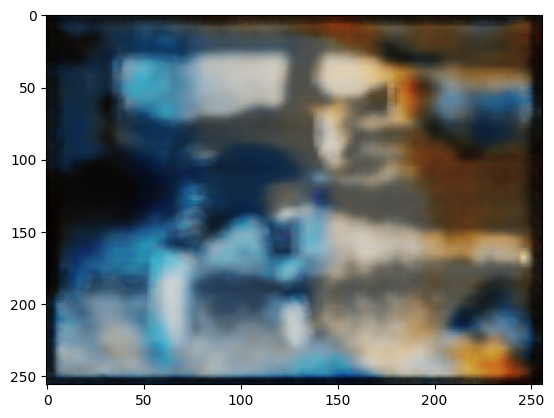

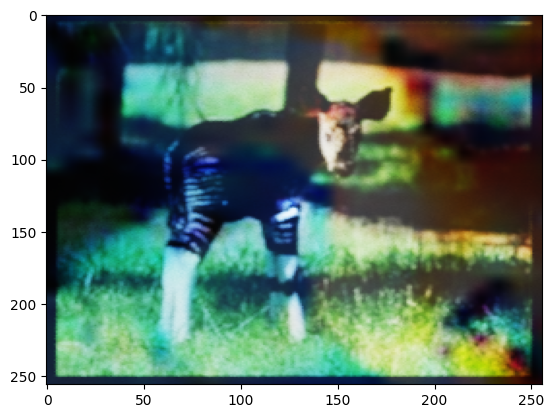

  0%|          | 19/10000 [00:51<7:15:55,  2.62s/it]

2025-06-30 20:56:33 WARN main [BitmapTextureImpl] BitmapTexture: texture named "WoodFloor064_1K-JPG_Color.jpg" contains pixels that exceed the [0, 1] range!

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


Epoch 20, Loss: 0.006481881253421307


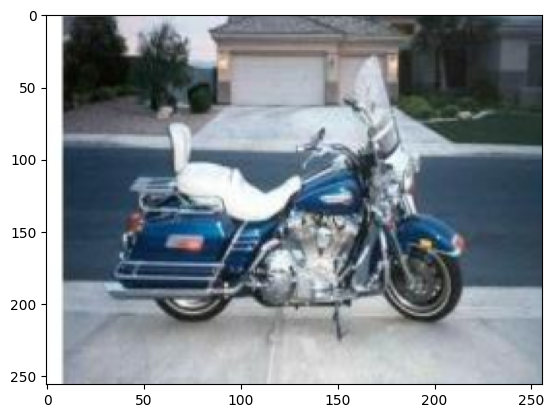

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.029821306..0.74340737].


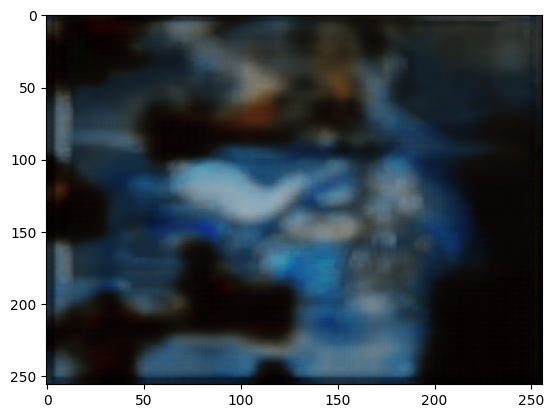

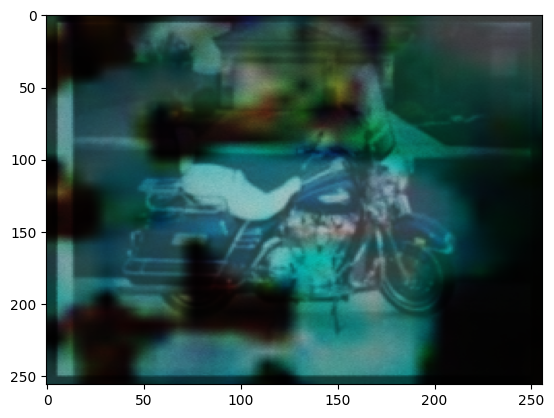

  0%|          | 20/10000 [00:54<8:02:09,  2.90s/it]

Epoch 21, Loss: 0.009166871197521687


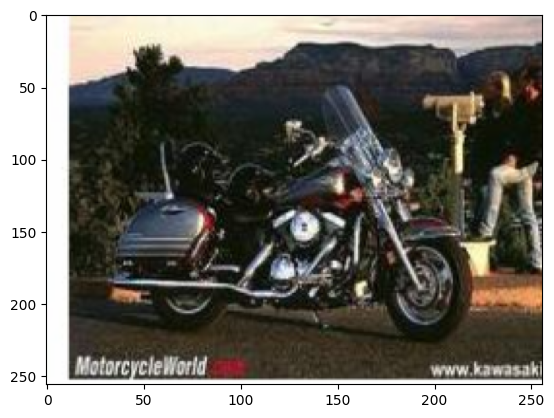

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0779627..0.6715728].


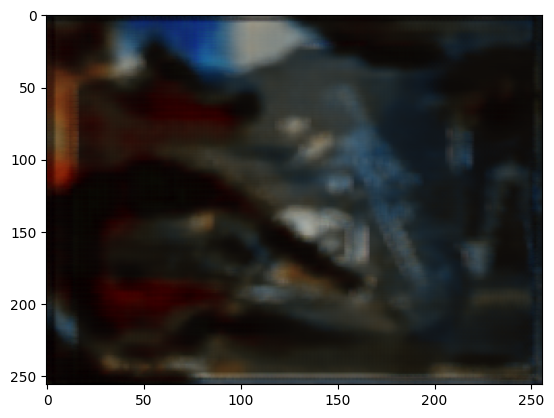

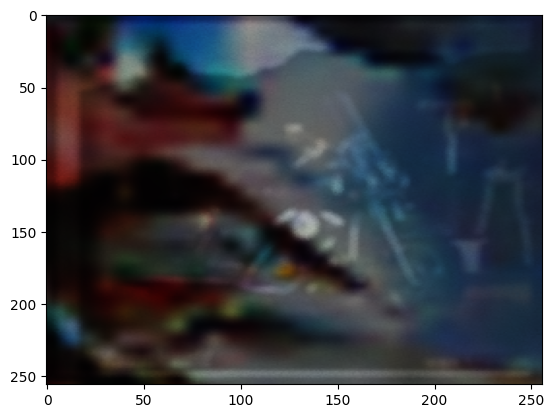

  0%|          | 21/10000 [00:58<8:27:08,  3.05s/it]

Epoch 22, Loss: 0.00847864244133234


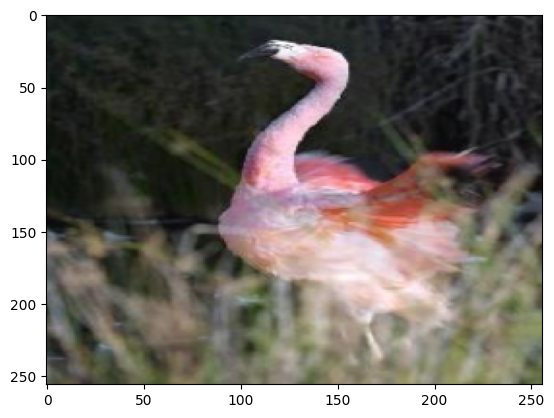

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0027384013..0.9436963].


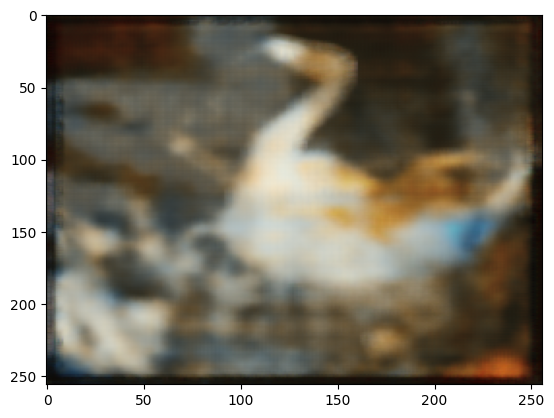

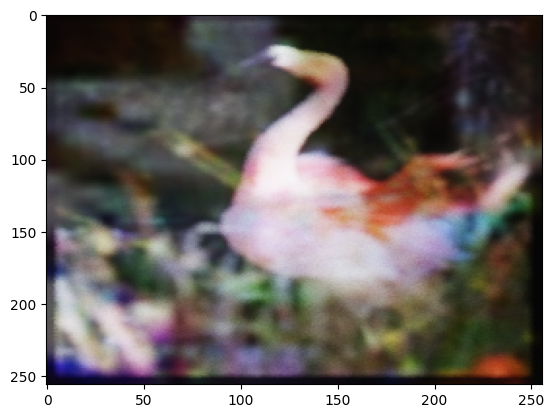

  0%|          | 22/10000 [01:01<8:18:10,  3.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


Epoch 23, Loss: 0.016849448904395103


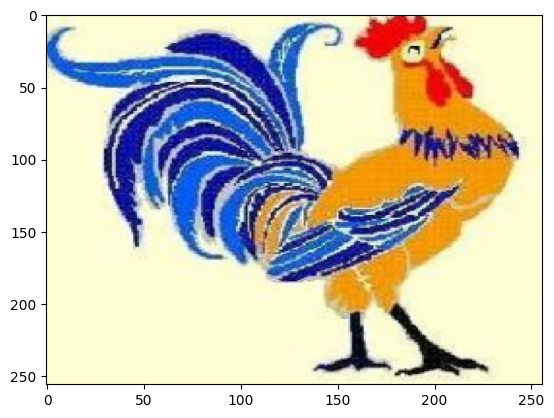

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.026009679..1.0632054].


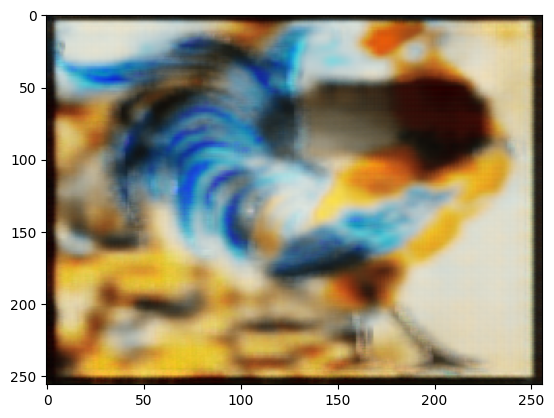

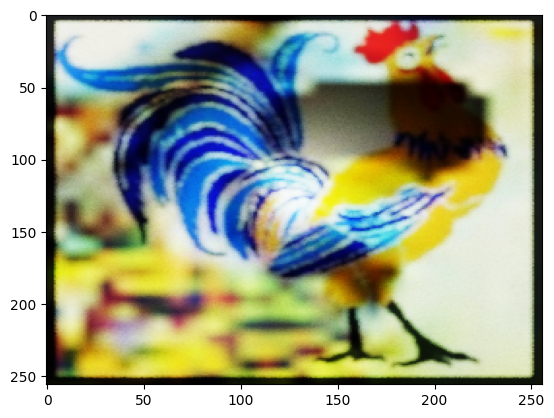

  0%|          | 23/10000 [01:03<7:56:57,  2.87s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.0000001].


Epoch 24, Loss: 0.004879425745457411


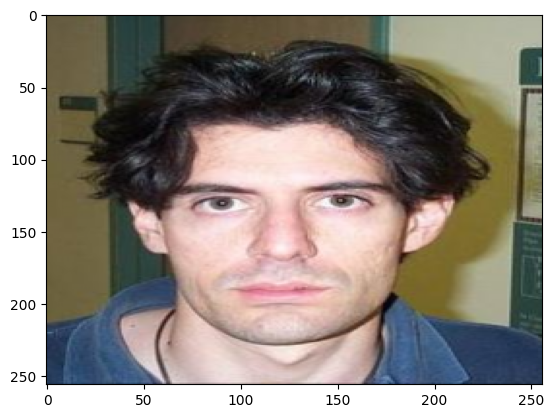

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0018628985..0.8600079].


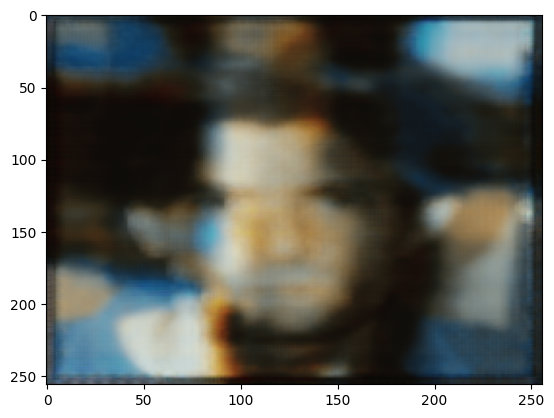

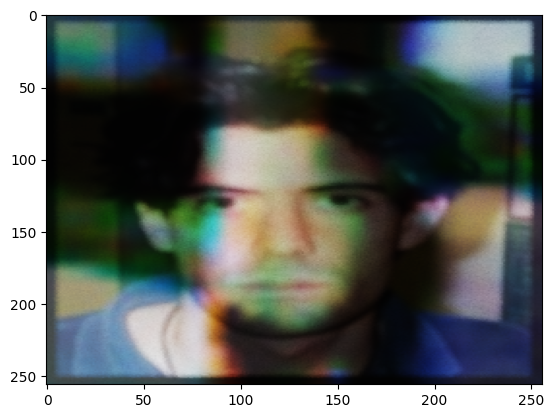

  0%|          | 24/10000 [01:06<7:53:54,  2.85s/it]

Epoch 25, Loss: 0.021879933774471283


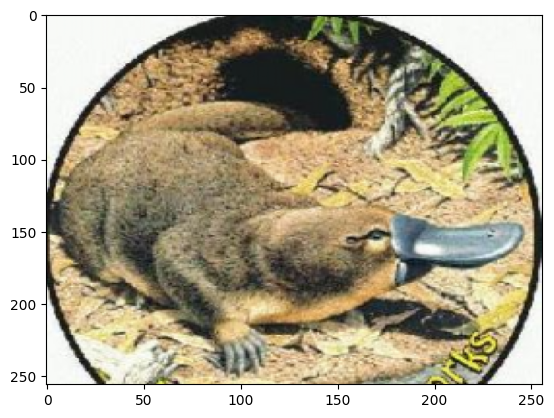

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015071221..0.9587736].


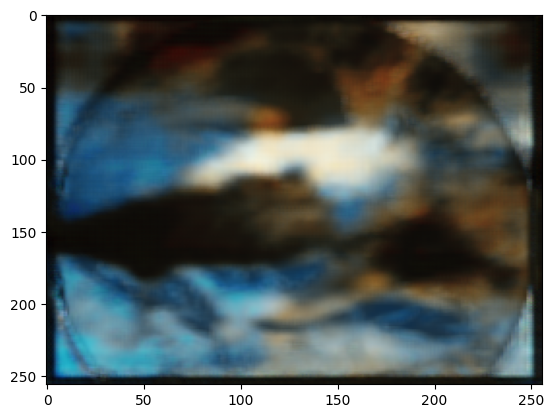

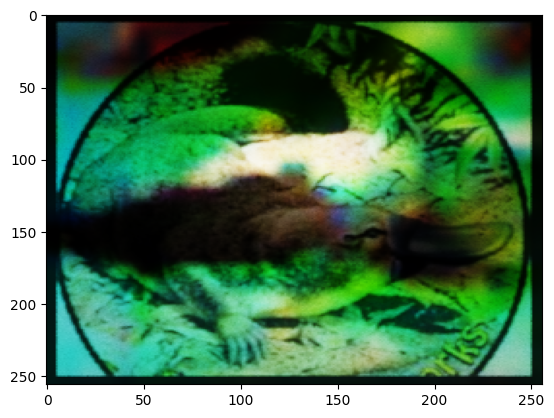

  0%|          | 25/10000 [01:09<7:55:16,  2.86s/it]

Epoch 26, Loss: 0.011425493285059929


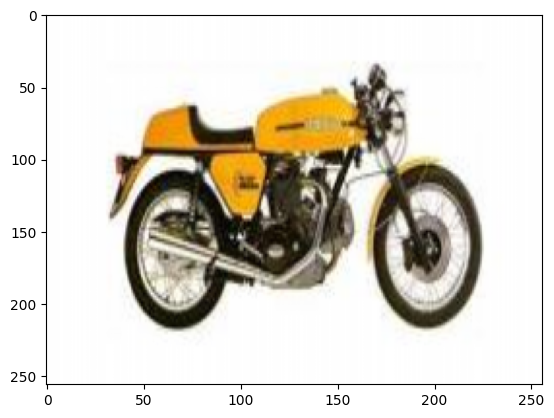

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0099963695..0.9610752].


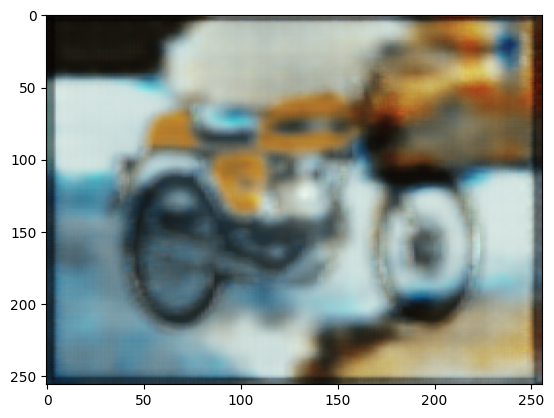

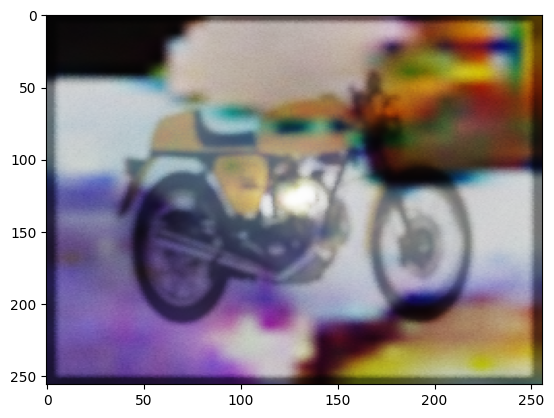

  0%|          | 26/10000 [01:11<7:36:48,  2.75s/it]

Epoch 27, Loss: 0.01949172094464302


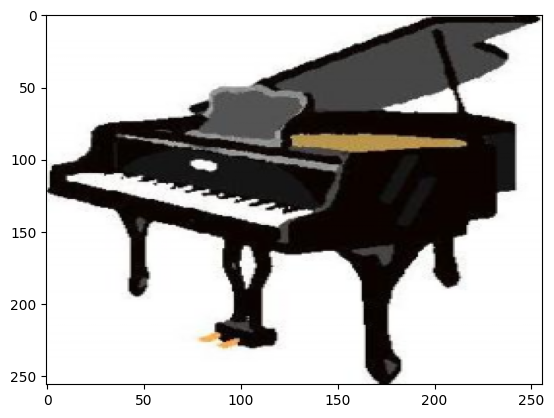

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.013156436..1.0142734].


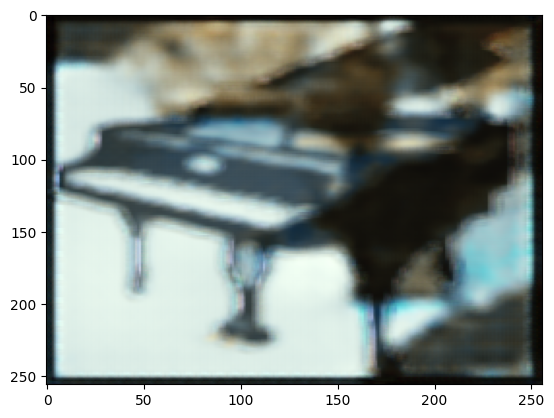

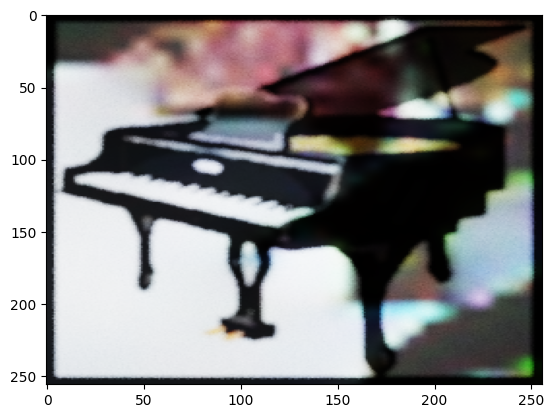

  0%|          | 27/10000 [01:14<7:34:47,  2.74s/it]

Epoch 28, Loss: 0.006376196630299091


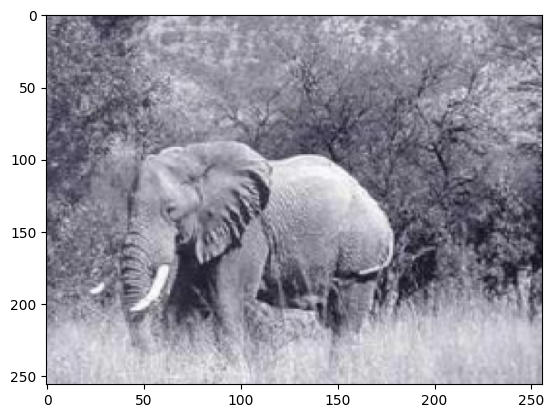

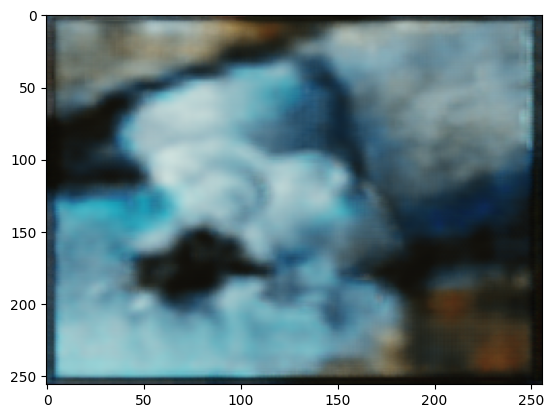

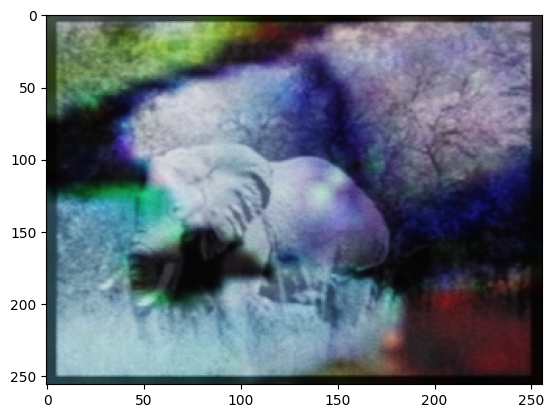

  0%|          | 28/10000 [01:18<8:10:29,  2.95s/it]

Epoch 29, Loss: 0.0033391350880265236


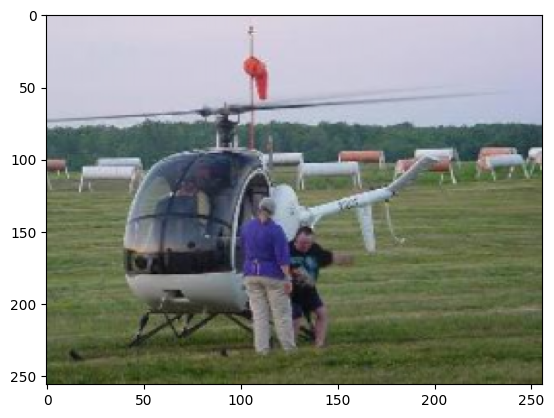

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0037028044..0.85652196].


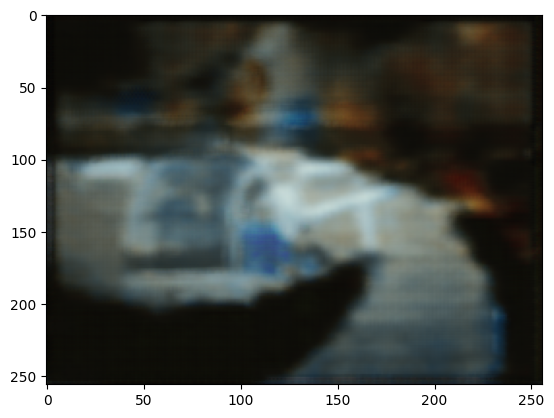

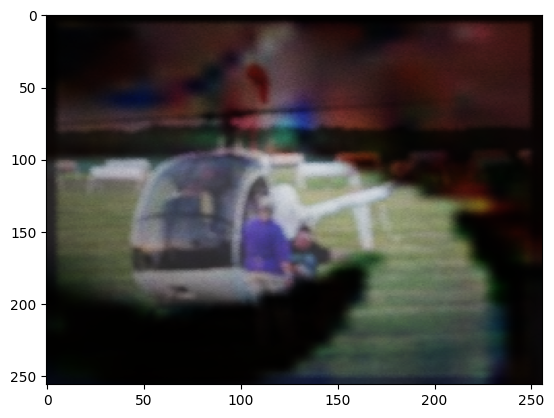

  0%|          | 29/10000 [01:21<8:18:51,  3.00s/it]

Epoch 30, Loss: 0.014875562861561775


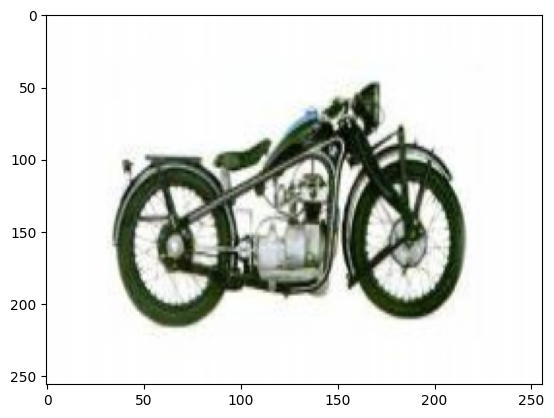

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.006264858..0.8680746].


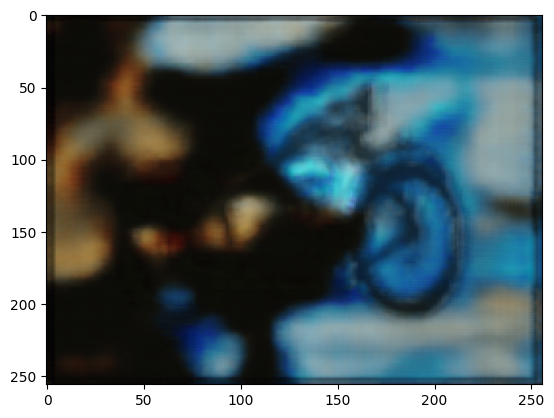

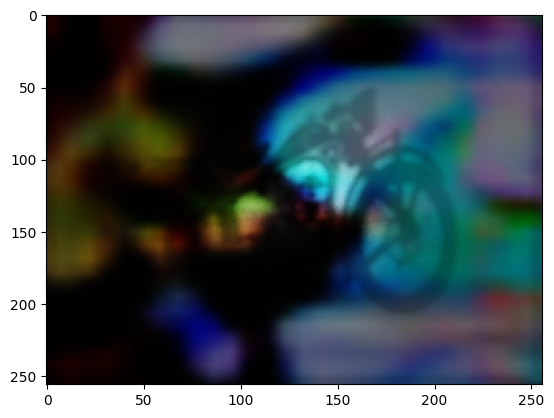

  0%|          | 30/10000 [01:23<8:01:32,  2.90s/it]

Epoch 31, Loss: 0.005907237529754639


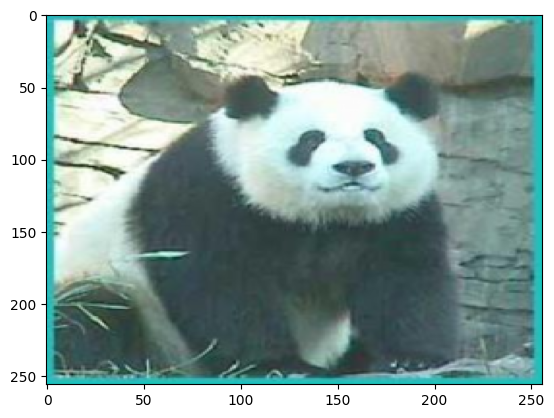

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0055431277..1.0567448].


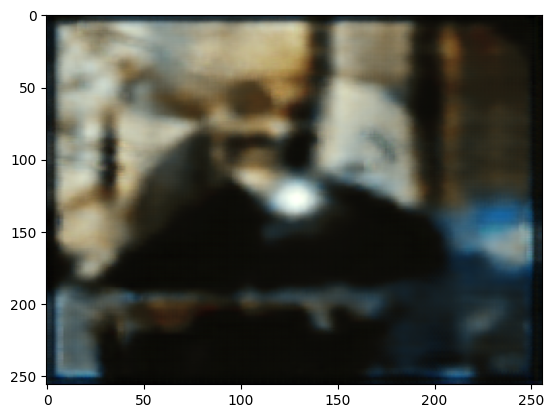

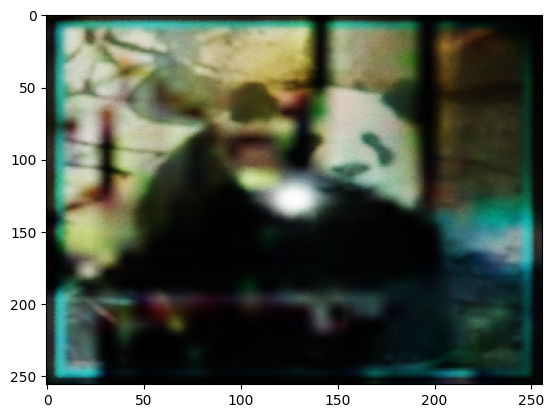

  0%|          | 31/10000 [01:26<7:41:19,  2.78s/it]

Epoch 32, Loss: 0.0024007707834243774


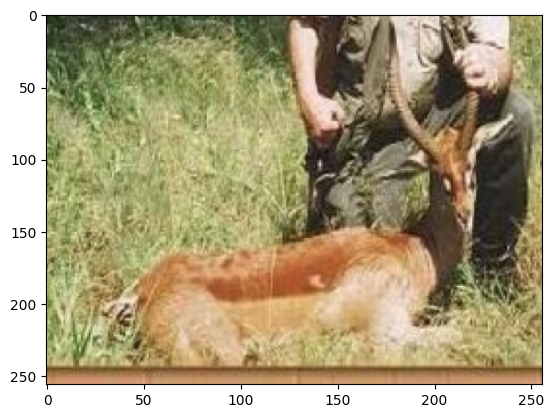

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.011352569..0.3717015].


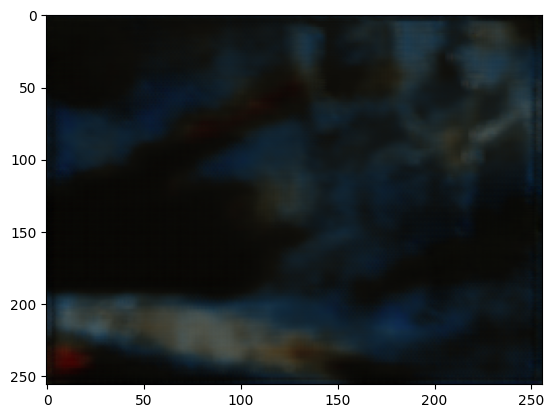

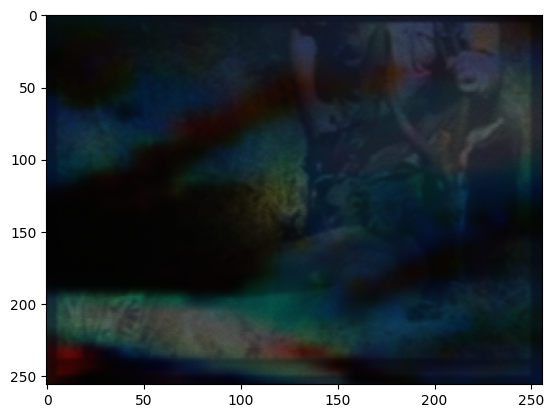

  0%|          | 32/10000 [01:28<7:30:21,  2.71s/it]

Epoch 33, Loss: 0.007934581488370895


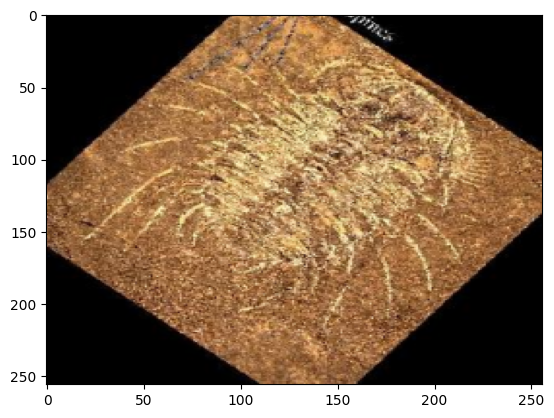

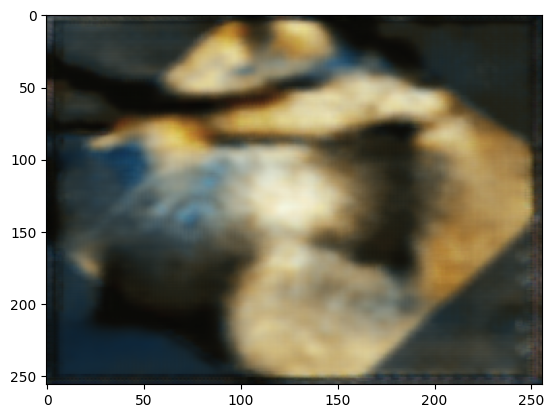

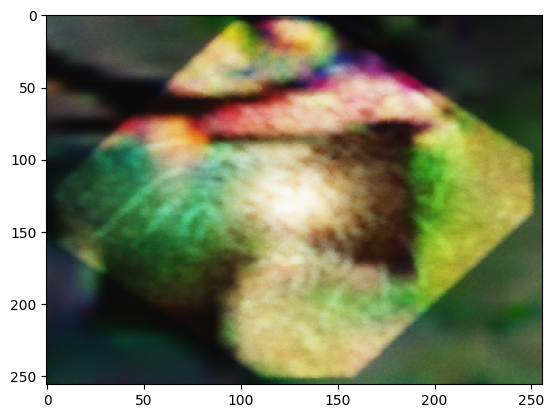

  0%|          | 33/10000 [01:31<7:21:14,  2.66s/it]

Epoch 34, Loss: 0.004025130067020655


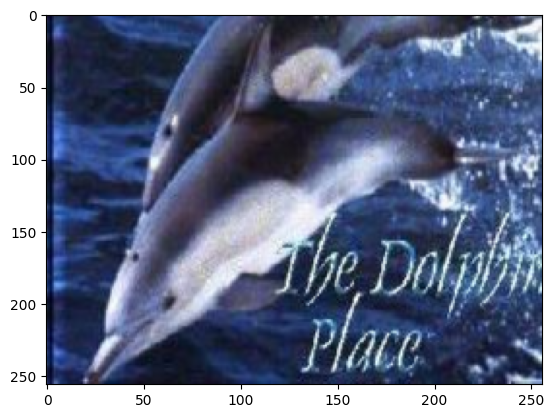

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.026618406..0.6179575].


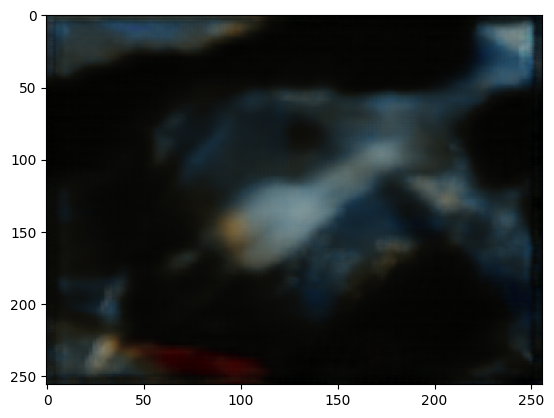

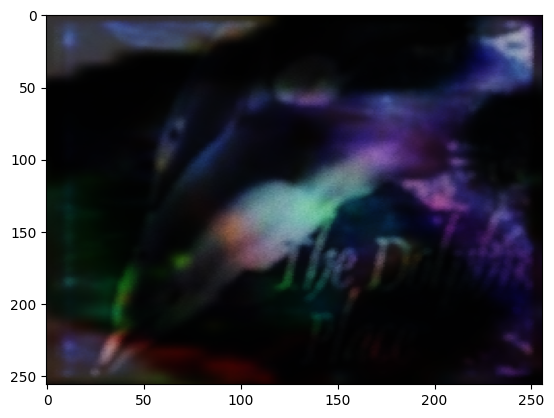

  0%|          | 34/10000 [01:34<7:20:33,  2.65s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0014563743..1.0000001].


Epoch 35, Loss: 0.002964823041111231


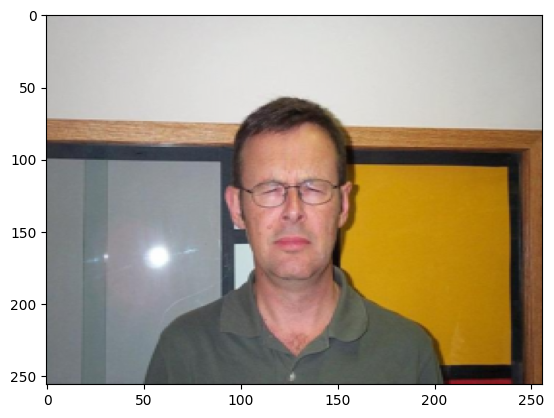

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02357106..0.43952838].


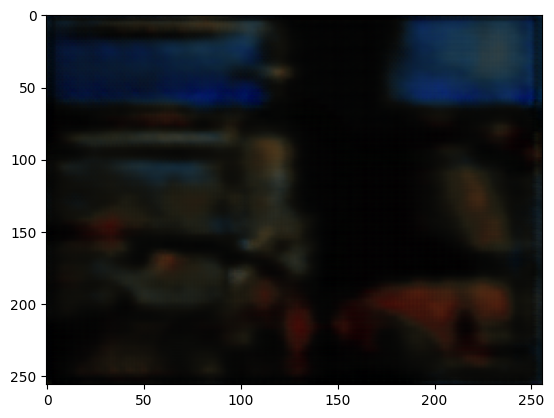

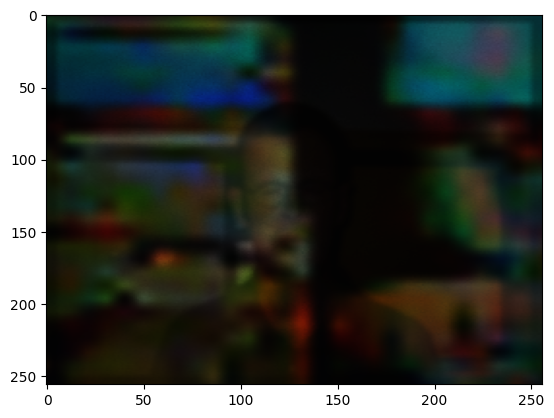

  0%|          | 35/10000 [01:36<7:29:23,  2.71s/it]

Epoch 36, Loss: 0.007057329639792442


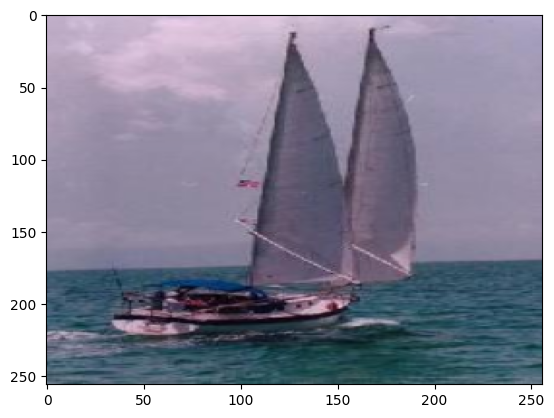

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.026190966..0.948668].


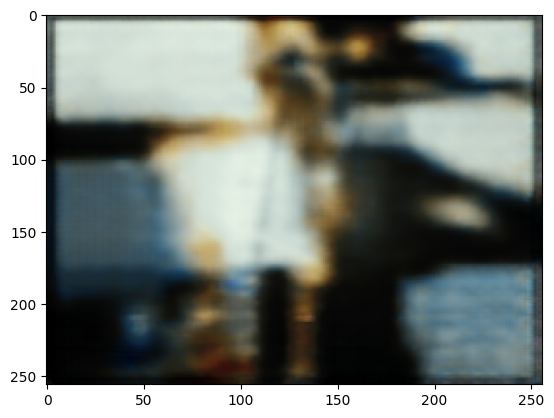

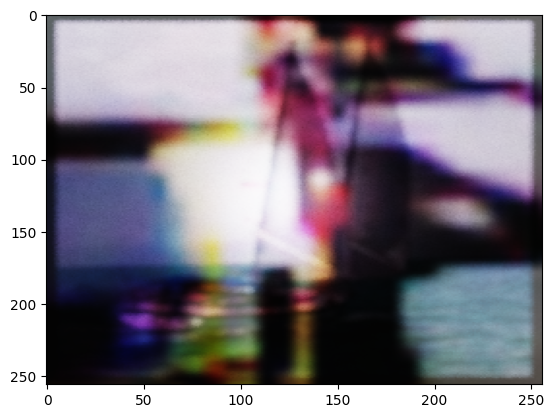

  0%|          | 36/10000 [01:39<7:20:34,  2.65s/it]

Epoch 37, Loss: 0.0023449340369552374


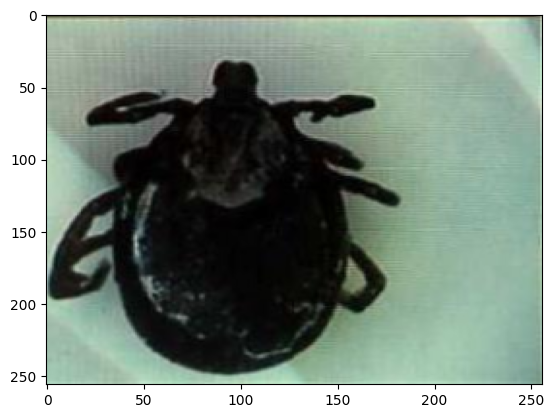

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.054723904..0.2954293].


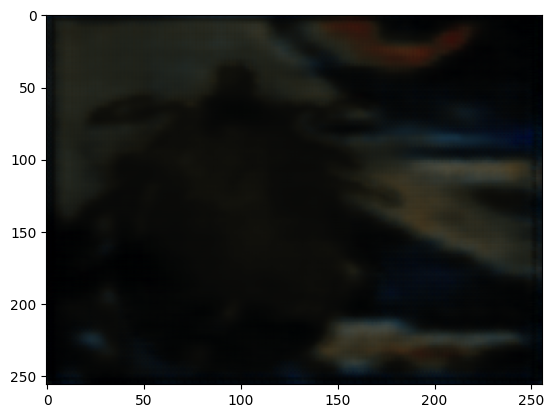

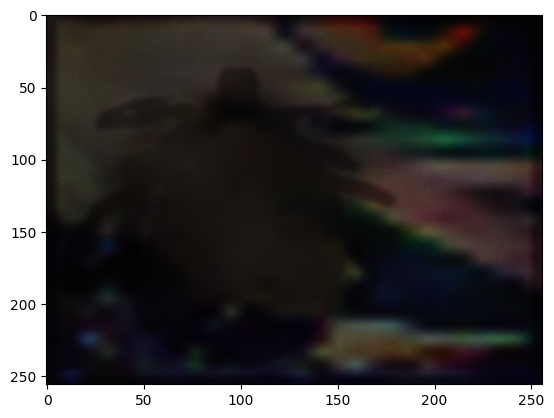

  0%|          | 37/10000 [01:42<7:20:40,  2.65s/it]

Epoch 38, Loss: 0.009798632934689522


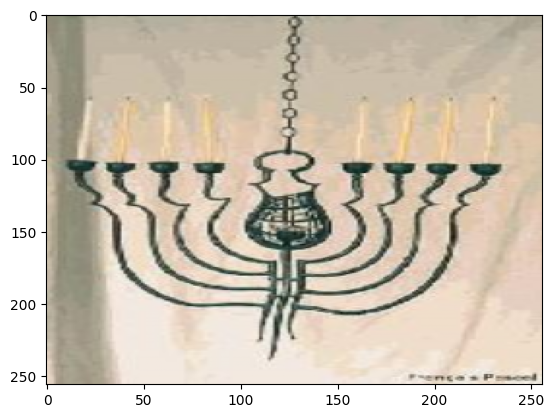

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.031540707..0.9088087].


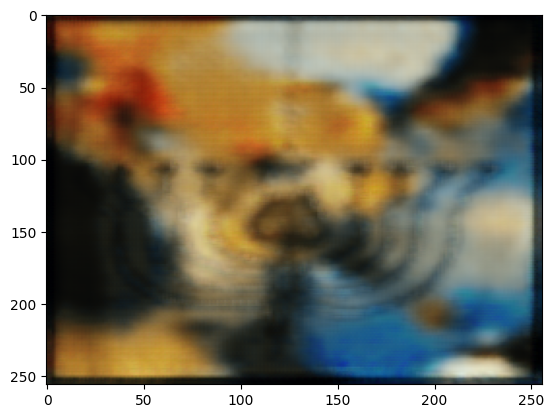

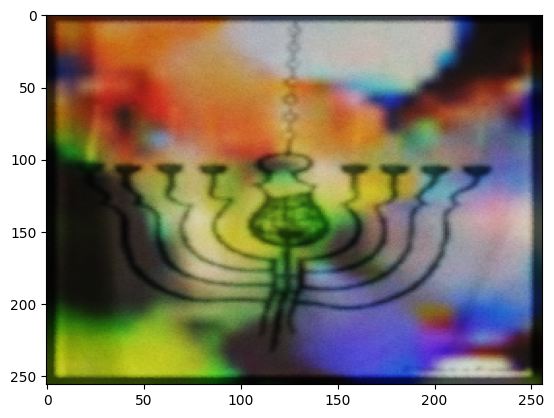

  0%|          | 38/10000 [01:44<7:28:22,  2.70s/it]

Epoch 39, Loss: 0.004233577288687229


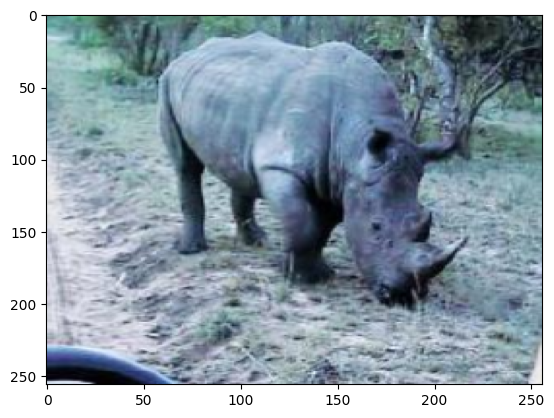

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.017522633..0.95301616].


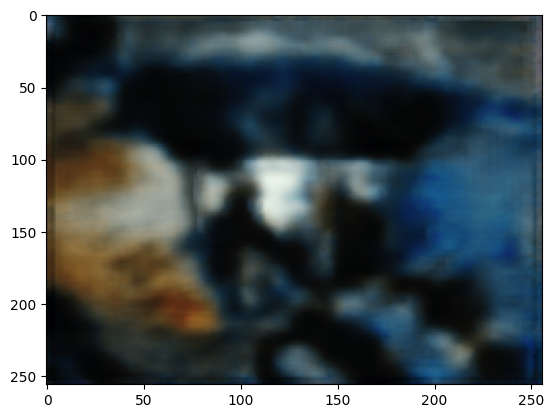

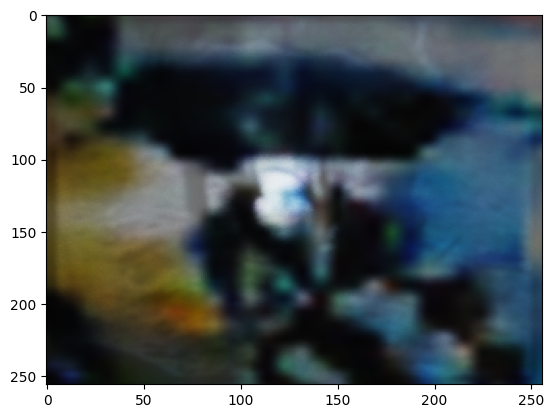

  0%|          | 39/10000 [01:47<7:23:23,  2.67s/it]

Epoch 40, Loss: 0.003046529134735465


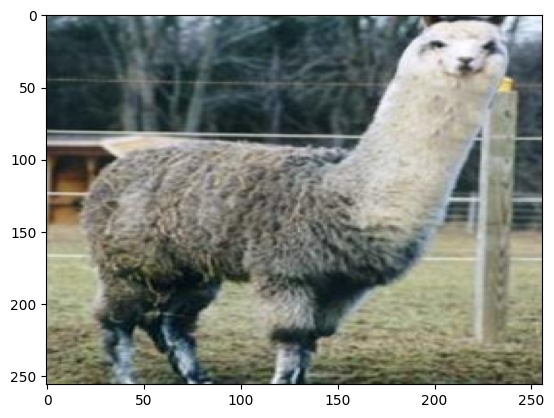

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.025651857..0.79872024].


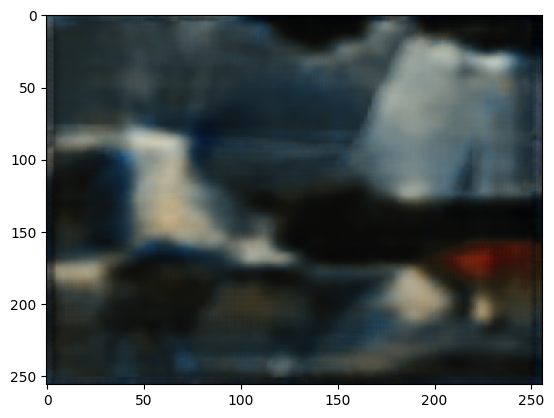

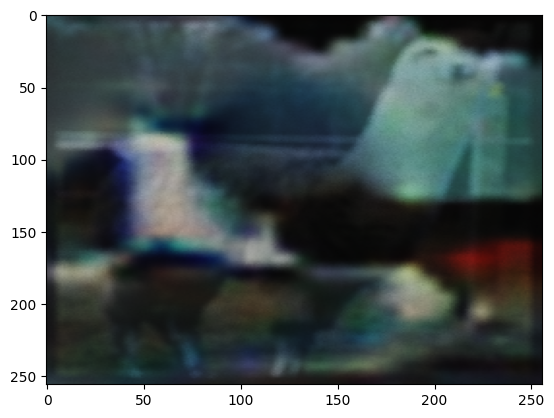

  0%|          | 40/10000 [01:52<7:46:55,  2.81s/it]

Epoch 41, Loss: 0.00987548753619194


KeyboardInterrupt: 

In [47]:
import tqdm
for epoch in tqdm.tqdm(range(10000)):

    random_caltech_photo = np.random.choice(ls)
    texture = cv2.cvtColor(cv2.imread(random_caltech_photo), cv2.COLOR_BGR2RGB)#gsoup.generate_voronoi_diagram(512, 512, 1000)*0+255
    proj_texture = gsoup.to_float(texture)
    proj_tex = torch.from_numpy(proj_texture).cuda() 
    proj_tex_r = resizer(proj_tex.permute(2, 0, 1))

    scene_dict = generate_random_scene()
    scene = mi.load_dict(scene_dict)
    params = mi.traverse(scene)

    optimizer.zero_grad()

    # Resize the learnable anchors to match the input size
    projected_anchors = []
    true_proj = render(params, proj_tex_r.permute(1,2,0))

    for anchor in learnable_anchors:
        resized_anchor = resizer(anchor)  # Change to HWC format
        projected_anchors.append(render(params, resized_anchor.permute(1,2,0)))
    
    projected_anchors = torch.stack(projected_anchors) 
    # raise
    condition = cnn_ds(projected_anchors.permute(0,3,1,2))

    model_input = torch.cat([proj_tex_r, condition])

    
    output = model(model_input)
    
    tv_loss = tv(learnable_anchors) / 1000
    
    loss = torch.nn.functional.mse_loss(output, true_proj.permute(2,0,1))  + tv_loss# Ensure true_proj is in (C, H, W) format
    
    loss.backward()
    optimizer.step()
    if (epoch) % 1 == 0:
        print(f"Epoch {epoch+1}, Loss: {loss.item()}")
        plt.imshow(proj_tex_r.permute(1,2,0).detach().cpu().numpy(), aspect='auto')
        plt.show()
        plt.imshow(output.permute(1,2,0).detach().cpu().numpy(), aspect='auto')
        plt.show()
        plt.imshow(true_proj.detach().cpu().numpy(), aspect='auto')
        plt.show()

        # Save the model state
        # torch.save(learnable_anchors, 'learnable_anchors.pth')
        # torch.save(model.state_dict(), 'light_cnn.pth')
        # torch.save(cnn_ds.state_dict(), 'cnn_downsample.pth')
        # Save the current learnable anchors
        
                

tensor([[[0.0143, 0.0087, 0.0083],
         [0.0129, 0.0082, 0.0080],
         [0.0120, 0.0079, 0.0080],
         ...,
         [0.0047, 0.0048, 0.0047],
         [0.0045, 0.0046, 0.0045],
         [0.0045, 0.0047, 0.0044]],

        [[0.0135, 0.0085, 0.0082],
         [0.0126, 0.0082, 0.0080],
         [0.0117, 0.0079, 0.0078],
         ...,
         [0.0043, 0.0043, 0.0042],
         [0.0046, 0.0045, 0.0044],
         [0.0047, 0.0047, 0.0045]],

        [[0.0133, 0.0086, 0.0084],
         [0.0125, 0.0084, 0.0082],
         [0.0120, 0.0082, 0.0080],
         ...,
         [0.0044, 0.0043, 0.0043],
         [0.0046, 0.0045, 0.0044],
         [0.0047, 0.0045, 0.0043]],

        ...,

        [[0.1329, 0.1749, 0.1928],
         [0.1314, 0.1723, 0.1904],
         [0.1313, 0.1712, 0.1895],
         ...,
         [0.0288, 0.0339, 0.0397],
         [0.0286, 0.0335, 0.0395],
         [0.0282, 0.0325, 0.0386]],

        [[0.1307, 0.1729, 0.1910],
         [0.1308, 0.1724, 0.1907],
         [0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.034837425..0.9123701].


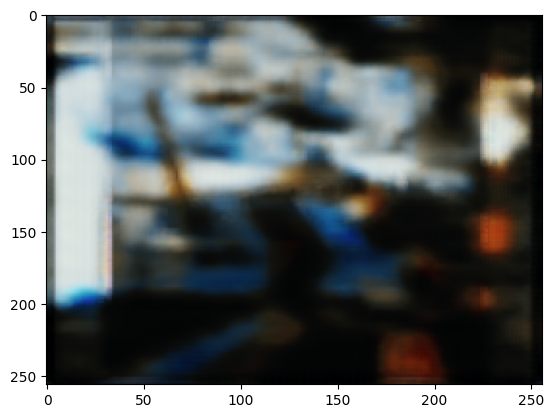

In [46]:
plt.imshow(output.permute(1,2,0).detach().cpu().numpy(), aspect='auto')

In [ ]:
pwd

'/home/dcor/niskhizov/AdversarialRendering/mitsuba/gsoup/src'

In [ ]:
learnable_anchors[4]

tensor([[[0.4984, 0.4984, 0.4984,  ..., 0.4983, 0.4983, 0.4983],
         [0.4984, 0.4984, 0.4984,  ..., 0.4985, 0.4985, 0.4985],
         [0.4986, 0.4985, 0.4984,  ..., 0.4985, 0.4984, 0.4984],
         ...,
         [0.4985, 0.4985, 0.4984,  ..., 0.4986, 0.4986, 0.4982],
         [0.4986, 0.4986, 0.4984,  ..., 0.4985, 0.4984, 0.4985],
         [0.4984, 0.4985, 0.4985,  ..., 0.4985, 0.4985, 0.4984]],

        [[0.4943, 0.4947, 0.4944,  ..., 0.4947, 0.4944, 0.4944],
         [0.4945, 0.4945, 0.4946,  ..., 0.4947, 0.4946, 0.4943],
         [0.4945, 0.4945, 0.4944,  ..., 0.4945, 0.4945, 0.4946],
         ...,
         [0.4944, 0.4948, 0.4942,  ..., 0.4944, 0.4946, 0.4946],
         [0.4946, 0.4944, 0.4945,  ..., 0.4946, 0.4945, 0.4945],
         [0.4947, 0.4943, 0.4946,  ..., 0.4947, 0.4945, 0.4948]],

        [[0.4990, 0.4987, 0.4987,  ..., 0.4990, 0.4989, 0.4989],
         [0.4989, 0.4986, 0.4988,  ..., 0.4991, 0.4988, 0.4988],
         [0.4988, 0.4989, 0.4987,  ..., 0.4988, 0.4988, 0.

In [52]:
projected_anchors[i].shape

torch.Size([256, 256, 3])

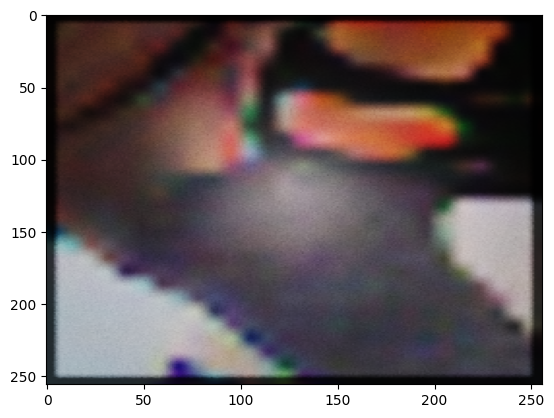

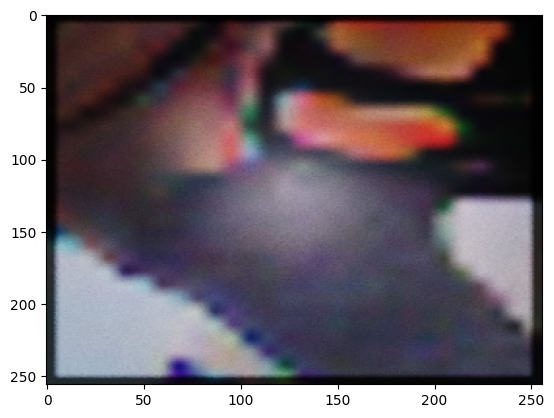

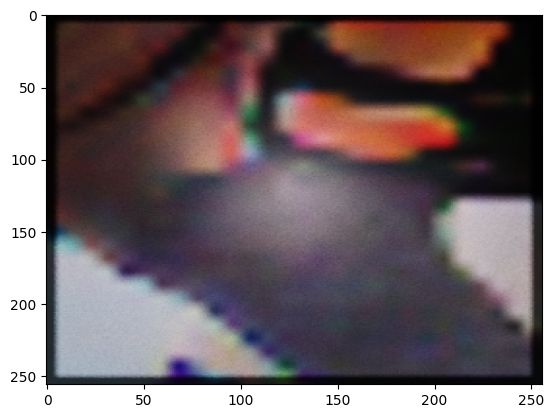

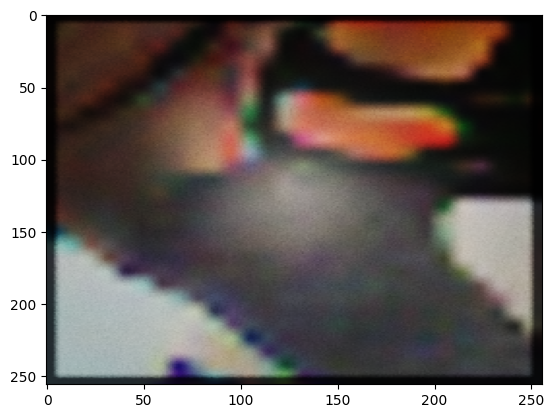

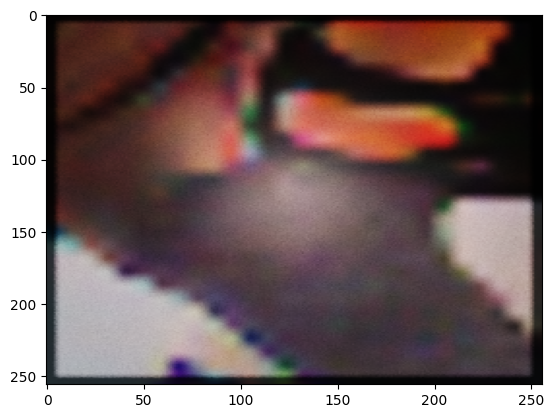

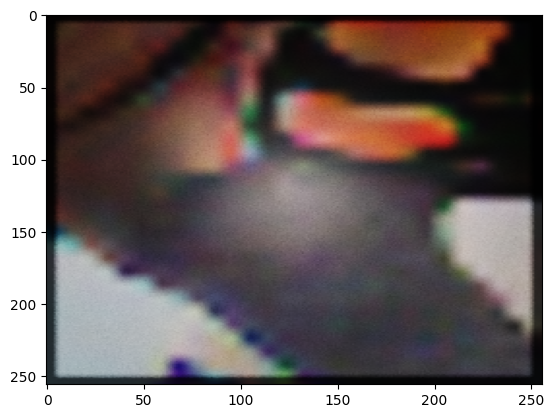

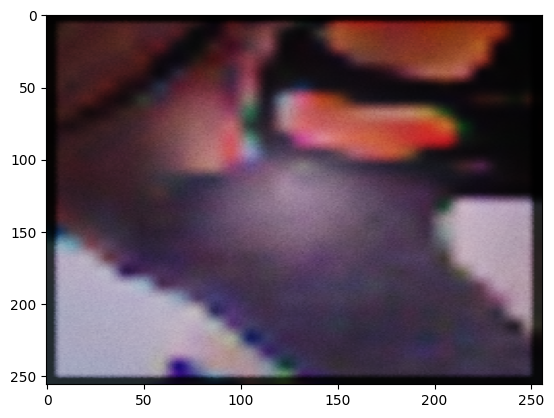

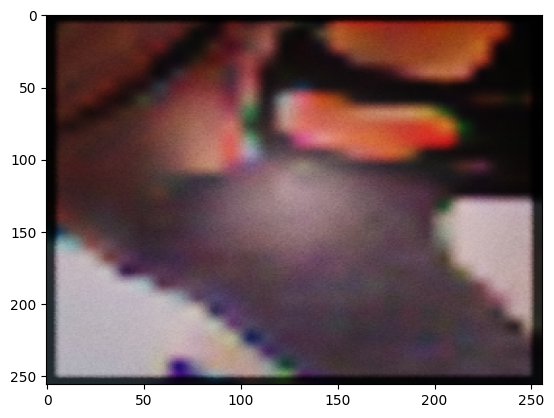

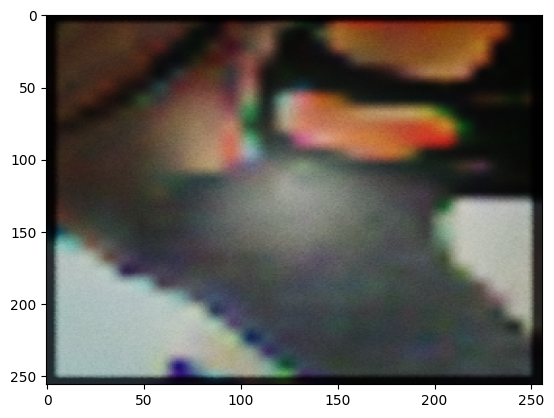

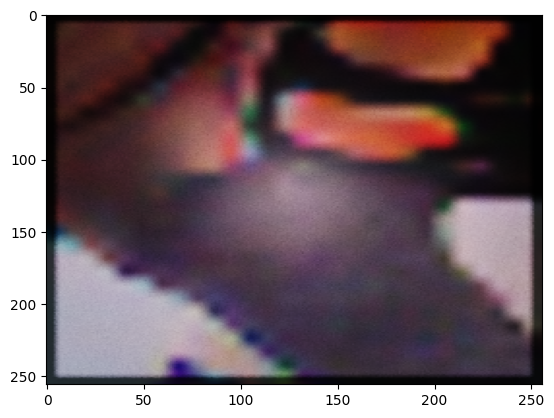

In [53]:
for i in range(learnable_anchors.shape[0]):
    plt.imshow(projected_anchors[i].cpu().detach().numpy(), aspect='auto')
    plt.show()


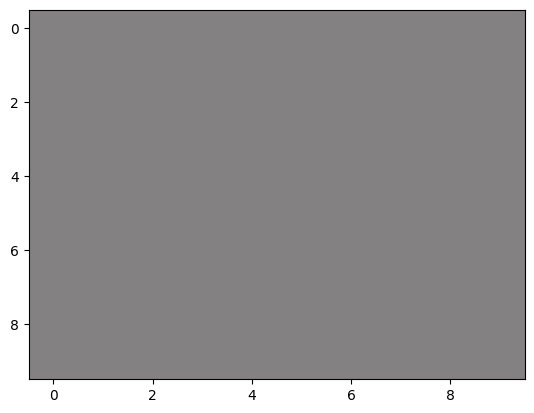

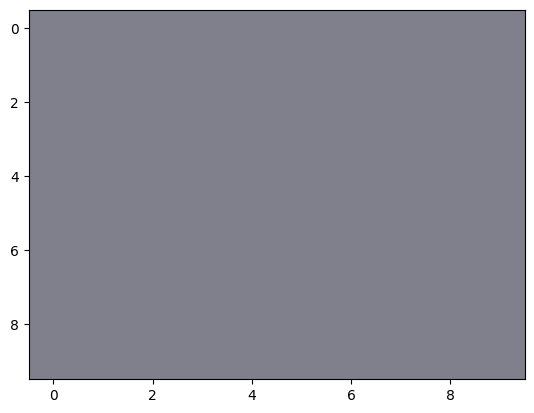

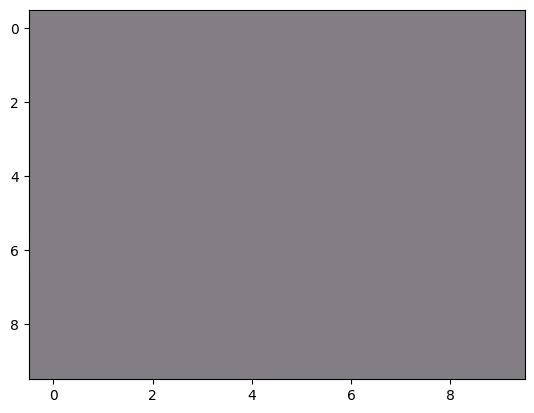

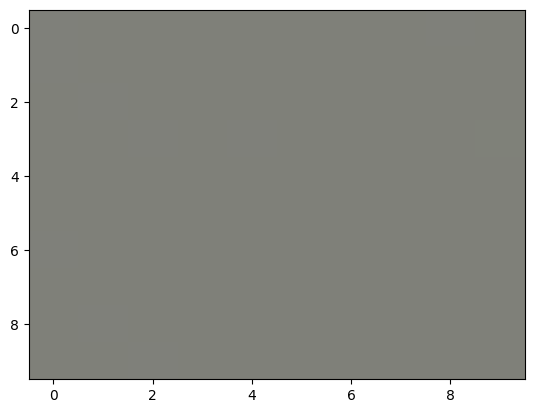

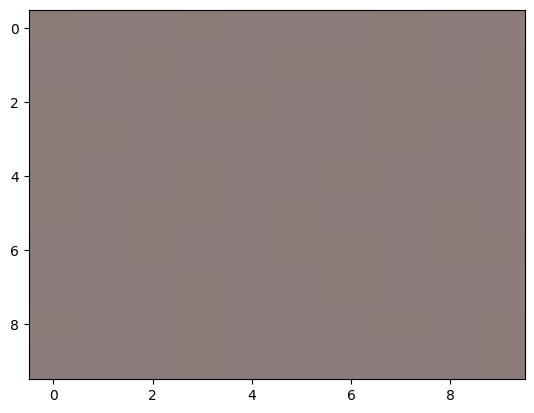

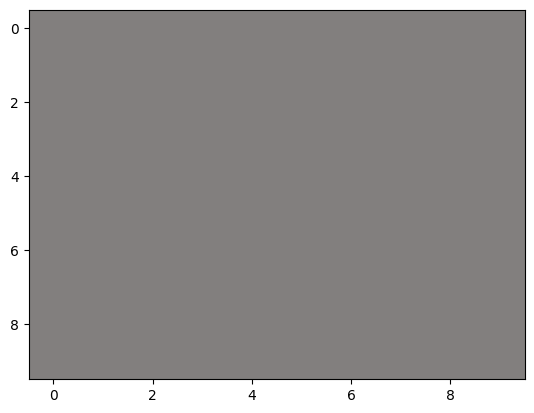

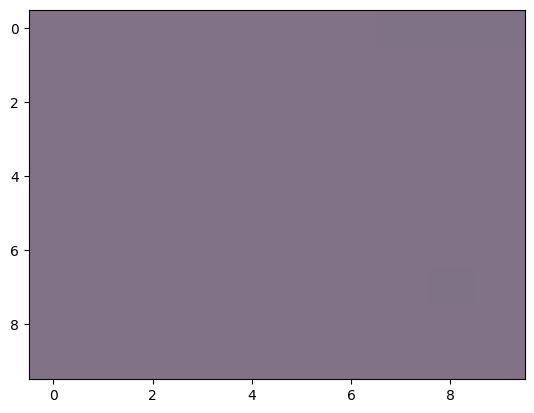

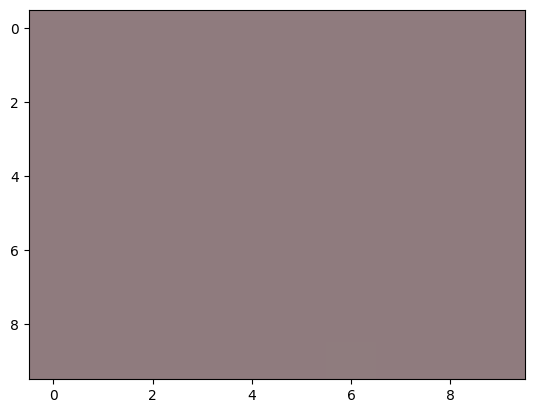

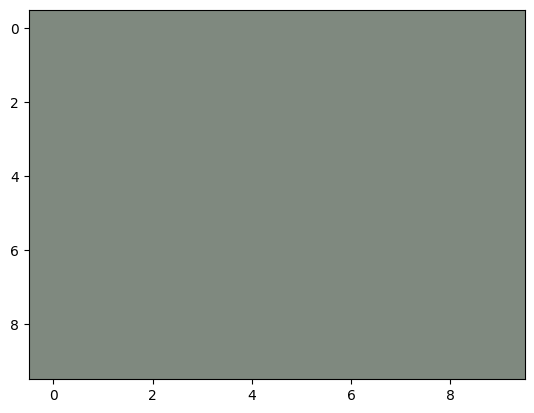

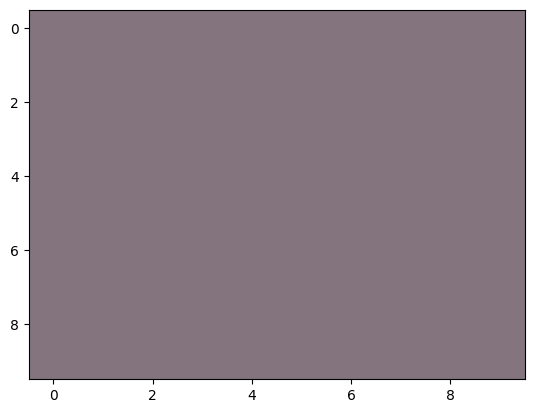

In [29]:
for i in range(learnable_anchors.shape[0]):
    plt.imshow(learnable_anchors[i].cpu().detach().numpy().transpose(1, 2, 0), aspect='auto')
    plt.show()


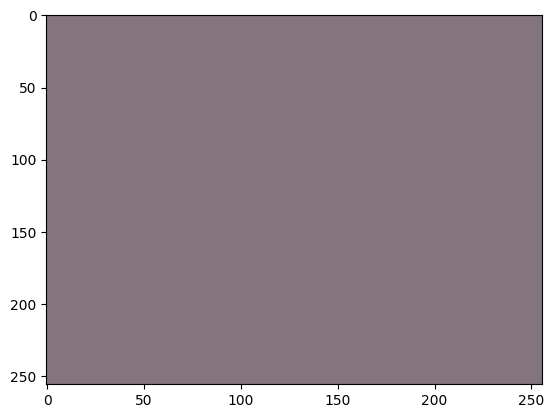

In [30]:
plt.imshow(resized_anchor.cpu().detach().numpy().transpose(1, 2, 0), aspect='auto')

In [ ]:
resized_anchor.shape

torch.Size([3, 256, 256])

In [ ]:
plt.imshow(projected_anchors[0].detach().cpu().numpy())

In [ ]:
plt.imshow(learnable_anchors[3].detach().permute(1,2,0).cpu().numpy())

In [ ]:
loss.backward()

In [ ]:
plt.imshow(true_proj.detach().cpu().numpy(), aspect='auto')

In [ ]:

proj_tex_grad = torch.from_numpy(proj_texture).requires_grad_(True).cuda() 

r = resizer(proj_tex_grad.permute(2,0,1)).permute(1,2,0)

final_image = render(params,r )

plt.imshow(final_image.detach().cpu().numpy(), aspect='auto')